<a href="https://colab.research.google.com/github/andresfeliper3/biopy-multifractal-analysis/blob/main/Biocode.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Documentation

### Sequence. RegionSequence, ThreePartRegionSequence

**Sequence**

Sequence *constructor*:
- sequence: string (Obligatory if *sequence_data* is None).
  - Explicit DNA sequence of A,T,C,G nucleotides. It is recommended to use BioPython to import the sequence from a fasta file to a fit string.
-  sequence_data: dict (Obligatory if *sequence* is None).
  - Dictionary which key-value pairs where the keys are "path" and "name" if the sequence.
- name: string (optional)
  - Name of the sequence. It can be used to identify the sequence from others.

A Sequence is the class for representing every single sequence of DNA of any organism.


---



**RegionSequence**

Inherits from *Sequence*.

RegionSequence class *constructor*:
- sequence: string (Obligatory if *sequence_data* is None).
  - Explicit DNA sequence of A,T,C,G nucleotides. It is recommended to use BioPython to import the sequence from a fasta file to a fit string.
- sequence_data: dict (Obligatory if *sequence* is None).
  - Dictionary which key-value pairs where the keys are "path" and "name" if the sequence.
- regions_number: integer
  - The amount of regions in which the string sequence of nucleotides must be divided. The size of the regions are all equals, except for the last one which will contain any remanining nucleotides.
- name: string (optional)
  - Name of the sequence. It can be used to identify the sequence from others.

A RegionSequence is the class for representing a DNA sequence that has been divided in equal-sized regions for analysis purposes.


---


**ThreePartRegionSequence**

Inherits from *RegionSequence*.

ThreePartRegionSequence class *constructor*:
- sequence: string
  - Explicit DNA sequence of A,T,C,G nucleotides. It is recommended to use BioPython to import the sequence from a fasta file to a fit string.
- name: string (optional)
  - Name of the sequence. It can be used to identify the sequence from others.

A ThreePartRegionSequence is the class for representing a DNA sequence that has been divided in three equal-sized regions for analysis purposes.



```
from Bio import SeqIO

# Path to the FASTA file
fasta_path= "c_elegans_chromosome_I.fasta"

# Read the FASTA file and get the DNA sequence
sequence_record = SeqIO.read(fasta_path, "fasta")

dna_sequence = Sequence(sequence=str(sequence_record.seq))

# Sample DNA sequence
sample_dna_sequence = Sequence(sequence="ATCGATCGATCGATCGATCG")

region_sequence = RegionSequence(sequence=str(sequence_record.seq), 3)

three_part_region_sequence = ThreePartRegionSequence(sequence=str(sequence_record.seq), name="Chromosome I")
```




### RandomSequence

**RandomSequence**

Inherits from *Sequence*.

RandomSequence class *constructor*:
- size: int
  - Size of the random sequence.

A RandomSequence is the class for representing a random-generated DNA sequence based on its indicated size. This class may be useful as a control sequence.



```
random_sequence = RandomSequence(size=1000)
```



### **Genome**

Genome class *constructor*:
- chromosomes: list[Sequence] (obligatory if *chromosomes_data* is None)
  - List of sequences, where each sequence represents a chromosome and a list of chromosomes represents a genome. This parameter should be None if *chromosomes_data* is being used.
- chromosomes_data: list[dict] (obligatory if *chromosomes* is None)
  - List of dictionaries, where each dictionary has metadata of one chromosome. Each dictionary has two key-values pairs: path and name. This parameter should be None if *chromosomes* is being used.
- regions_number: integer (Optional)
  - The amount of regions in which all the chromosomes sequences must be divided for analysis. All the chromosomes are divided equally and each region has the same size, except for the last one that may contain the remaining nucleotides.

Genome is the class for representing the whole genome of an organism. Its sequences/chromosomes can be optionally divided in regions.



self, chromosomes: list[Sequence]=None, chromosomes_data: list[dict]=None, regions_number: int=0):

### **Graphs**

This is a class whose purpose is to generate predefined graphs for the MFA. It must not be instantiated, but used as a static class instead.
The methods it allows:
- graph_one
  - *Obligatory args*: x_array, y_array, x_label, y_label, title.
  - It is used to graph a single line or behavior.
- graph_many
  - *Obligatory args*: results_array, X, Y, x_label, y_label, title.
  - *Optional args*: markers_array, linestyles_array, colors_array labels_array, markersize.
  - It is used to graph multiple lines or behaviors in a single graph.
- graph_bars
  - *Obligatory args*: x_array, y_array, title.
  - *Optional args*: y_label, bar_labels, bar_colors, legend, rotation, y_range.
  - It is used to graph a bar chart from X-values and Y-values.
- graph_3d_cgr
  - *Obligatory args*: count_matrix
  - *Optional args*: title, x_start, x_end, y_start, y_end, epsilon.
  - It is used to graph a 3D bar chart which shows the CGR where the height of each bar represents the density of points in that box of epsilon size.
- graph_cgr
  - *Obligatory args*: x_coords, y_coords.
  - *Optional args*: grid_size, epsilon, marker, markersize, title, x_label, y_label, x_start, x_end, y_start, y_end, with_grid, linecolor, linewidth.
  - It graphs the entire Chaos Representation Game (CGR) from the x_coords and y_coords generated. It can be graphed with or without the grid.
                       



### **CGR**
CGR constructor:
- sequence: Sequence.
  - A Sequence instance where the CGR is going to be generated from.
- corners: dict (optional).
  - A dictionary with the nucleotides coordinates in the CGR. The nucleotide is represented in the key. The coordinate is represented as a tuple in the value. A predefined `{'A': (0, 0), 'C': (0, 1), 'G': (1, 1), 'T': (1, 0)}` has been set.

This class allows to generate and graph the Chaos Representation Game (CGR) using Graphs class.

This class allows to generate and graph the CGR while counting the amount of points in each cell/box of size epsilon. It creates a matrix of numbers, where the element *i,j* represents the amount of points and the coordinates i and j represent the position of the box in the grid.

The *mi_grid* matrix is generated by this class, then.

### **MFA**
MFA constructor:
- mi_grid: matrix of numbers.
  - This matrix of numbers is a mxn matrix where mxn represents the size of the grid.
  The i and j coordinates represent the position of each cell or box.
  Every *i,j* element (number) represents the amount of points in each cell or box after the execution of the CGR algorithm.

This class allows to do a Multifractal Analysis (MFA) after the execution of the CGR algorithm on a DNA sequence. Every useful data generated from the CGR of the algorithm should be calculated by this class.

Some of the values it can calculate are:
- q values (it uses [-20, 21] by default).
- Dq values.
- Dq max.
- Dq min.
- DDq (degree of multifractality).
- total fractal points.
- tau q values.

It generates a dictionary where it saves some of the data needed to generate graphs.
This dictionary is called *results* and its structure is:

```
 self.result = {
        'q_values': self.q_values,
        'Dq_values': self.Dq_values,
        'tau_q_values': self.tau_q_values,
        'DDq': self.DDq
    }
```




# Install

In [ ]:
!pip install Bio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 279.4/279.4 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 46.3 MB/s eta 0:00:00


# Classes and functions

## Imports


In [230]:
import numpy as np
import matplotlib.pyplot as plt
from itertools import cycle
from Bio import SeqIO


## Classes

### Sequence. RegionSequence, ThreePartRegionSequence



In [231]:

class Sequence():
  def __init__(self, sequence: str = None, sequence_data: dict = None, name: str = None):
    if sequence:
      self.sequence = sequence
      self.name = name
    elif sequence_data:
      self.sequence = str(SeqIO.read(sequence_data['path'], "fasta").seq)
      self.name=sequence_data['name']
    self.size = len(self.sequence)

  def get_sequence(self) -> str:
    return self.sequence

  def get_size(self) -> int:
    return self.size

  def set_name(self, name):
    self.name = name

  def get_name(self) -> str:
    return self.name

In [232]:
class RegionSequence(Sequence):
  def __init__(self, sequence: str = None, sequence_data: dict = None, regions_number: int = 0, name: str = None):
    super().__init__(sequence=sequence, sequence_data=sequence_data, name=name)
    self.regions_number = regions_number
    self.regions = []
    self.regions_names = []
    self.calculate_regions()

  def set_regions_number(self, regions_number):
    self.regions_number = regions_number
    self.calculate_regions(self, self.regions_number)

  def calculate_regions(self):
    if self.regions_number is None or self.regions_number <= 0:
      raise Exception('Enter a valid regions number')
    else:
      self.region_common_size = self.get_size() // self.regions_number
      for i in range(self.regions_number):
        start = i * self.region_common_size
        end = (i + 1) * self.region_common_size if i < self.regions_number - 1 else None
        region = self.sequence[start:end]
        self.regions.append(Sequence(sequence=region, name=f"{self.name}_region_{i+1}"))
        self.regions_names.append(f"{self.name}_region_{i+1}")

  def get_regions(self) -> list[Sequence]:
    return self.regions

  def get_regions_number(self) -> int:
    return self.regions_number

  def get_regions_sizes(self) -> list[int]:
    return np.array([len(region.get_sequence()) for region in self.regions])

  def get_regions_names(self) -> list[str]:
    return self.regions_names


In [233]:
class ThreePartRegionSequence(RegionSequence):
  def __init__(self, sequence: str = None, sequence_data: dict = None, name: str = None):
    super().__init__(sequence, sequence_data, 3, name)
    super().calculate_regions()

  def set_regions_number(self, regions_number):
    if regions_number != self.regions_number:
      raise Exception("It is not possible to change the regions number of a ThreePartRegionSequence instance")

### RandomSequence

**RandomSequence**

Inherits from *Sequence*.

RandomSequence class *constructor*:
- size: int
  - Size of the random sequence.

A RandomSequence is the class for representing a random-generated DNA sequence based on its indicated size. This class may be useful as a control sequence.

In [234]:
import random

class RandomSequence(Sequence):

  def __init__(self, size: int):
    super().__init__("")
    self.nucleotides = ['A', 'T', 'C', 'G']
    self.size = size
    self.refresh()

  def _generate_random_nucleotide(self):
    random_number = random.randint(0, 3)
    random_nucleotide = self.nucleotides[random_number]
    return random_nucleotide


  def refresh(self):
    seq = ""
    for i in range(self.size):
      seq += self._generate_random_nucleotide()
    self.sequence = seq




### Genome

In [235]:
from Bio import SeqIO

class Genome():
  def __init__(self, chromosomes: list[Sequence]=None, chromosomes_data: list[dict]=None, regions_number: int=0):
    if regions_number < 0:
      raise Exception("Enter a valid regions_number for the Genome")
    elif regions_number == 0:
      if chromosomes:
        self.chromosomes = chromosomes
      elif chromosomes_data:
        self.chromosomes = []
        for data in chromosomes_data:
            self.chromosomes.append(Sequence(str(SeqIO.read(data['path'], "fasta").seq), name=data['name']))
    else: # with regions number
      if chromosomes:
        self.chromosomes = [RegionSequence(sequence=chromosome.get_sequence(), regions_number=regions_number) for chromosome in chromosomes]
      elif chromosomes_data:
        self.chromosomes = []
        for data in chromosomes_data:
            self.chromosomes.append(RegionSequence(sequence=str(SeqIO.read(data['path'], "fasta").seq), name=data['name'],
                                                   regions_number=regions_number))


    self.number_of_chromosomes = len(self.chromosomes)
    self.chromosomes_names = [chromosome.get_name() for chromosome in self.chromosomes]

  def add_chromosome(self, chromosome):
    self.chromosomes.append(chromosome)

  def get_number_of_chromosomes(self) -> int:
    return self.number_of_chromosomes

  def get_chromosomes(self) -> list[Sequence]:
    return self.chromosomes

  def _calculate_chromosomes_sizes(self):
    self.chromosomes_sizes = [chromosome.get_size() for chromosome in self.chromosomes]

  def get_chromosomes_sizes(self) -> list[int]:
    self._calculate_chromosomes_sizes()
    return self.chromosomes_sizes

  def get_genome_size(self) -> int:
    self._calculate_chromosomes_sizes()
    return sum(self.chromosomes_sizes)

  def get_chromosomes_names(self) -> list[str]:
    return self.chromosomes_names






### Graphs


In [236]:
class Graphs:

  @staticmethod
  def graph_one(x_array, y_array, x_label, y_label, title):
    plt.figure(figsize=(10, 6))
    plt.plot(x_array, y_array, marker='o')
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    plt.grid()
    plt.show()


  @staticmethod
  def graph_many(results_array, X, Y, x_label, y_label, title, markers_array=None, linestyles_array=None, colors_array=None, labels_array=None,
                 markersize=6):
        plt.figure(figsize=(10, 6))

        if markers_array is None:
            markers = ['o', 's', '^', 'v', '>', '<', 'p', 'D', 'h']
            marker_cycle = cycle(markers)
        else:
            marker_cycle = cycle(markers_array)

        for index, result in enumerate(results_array):
            marker = next(marker_cycle)
            linestyle = linestyles_array[index] if linestyles_array else '-'
            color = colors_array[index] if colors_array else None
            label = labels_array[index] if labels_array else None

            plt.plot(result[X], result[Y], marker=marker, linestyle=linestyle, color=color, label=label, markersize=markersize)

        plt.xlabel(x_label)
        plt.ylabel(y_label)
        plt.title(title)
        plt.grid()
        plt.legend()
        plt.show()

  # overload graph_many

  @staticmethod
  def graph_bars(x_array, y_array, title, y_label=None, bar_labels=None, bar_colors=None, legend=None, rotation=45, y_range=[0,2]):
    fig, ax = plt.subplots()
    ax.bar(x_array, y_array, label=bar_labels, color=bar_colors)
    ax.set_ylabel(y_label)
    ax.set_ylim(y_range[0], y_range[1])
    ax.set_title(title)
    ax.set_xticks(x_array)
    ax.set_xticklabels(x_array, rotation=rotation)
    ax.legend(title=legend)
    plt.show()


  """
  This function graphs the CGR representation in 3D to visualize the density of the boxes.
  The nucleotides are in the same position but rotated 45° clockwise.
  The function receives the X, Y starting and ending numbers, the epsilon value (box size)
  and the count_matrix, which is the matrix where [i,j] value is the amount of points in the box [i,j]
  """
  @staticmethod
  def graph_3d_cgr(count_matrix: list[list[int]], title='Multifractal measure representation', x_start=0, x_end=1, y_start=0, y_end=1, epsilon=0.01):
    # set up the figure and axes
    fig = plt.figure(figsize=(8, 6))
    ax1 = fig.add_subplot(111, projection='3d')

    _x = np.arange(x_start, x_end, epsilon)
    _y = np.arange(y_start, y_end, epsilon)
    _xx, _yy = np.meshgrid(_x, _y)
    x, y = _xx.ravel(), _yy.ravel()

    # Flatten the count_matrix into a 1D array
    Z = count_matrix.flatten()
    bottom = np.zeros_like(Z)
    width = epsilon
    depth = epsilon

    ax1.bar3d(x, y, bottom, width, depth, Z, shade=True)
    ax1.set_title(title)
    plt.show()


  @staticmethod
  def graph_cgr(x_coords, y_coords, grid_size=None, epsilon=None, marker='o', markersize=0.005, title="Chaos Game Representation", x_label="X", y_label="Y",
                        x_start=0, x_end=1, y_start=0, y_end=1, with_grid=True, linecolor='red', linewidth=0.1):
    # Plot the points
    plt.figure(figsize=(10, 10))
    plt.plot(x_coords, y_coords, marker, markersize=markersize)
    plt.title(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.xlim(x_start, x_end)
    plt.ylim(y_start, y_end)
    # Set aspect ratio and remove axis
    plt.gca().set_aspect('equal', adjustable='box')
    #plt.axis('off')

    if with_grid:
      square_width = epsilon
      # Plot grid lines for each square
      for i in range(grid_size + 1):
          plt.axvline(i * square_width, color=linecolor, linewidth=linewidth)
          plt.axhline(i * square_width, color=linecolor, linewidth=linewidth)

    plt.show()



### CGR
CGR constructor:
- sequence: Sequence.
  - A Sequence instance where the CGR is going to be generated from.
- corners: dict (optional).
  - A dictionary with the nucleotides coordinates in the CGR. The nucleotide is represented in the key. The coordinate is represented as a tuple in the value. A predefined `{'A': (0, 0), 'C': (0, 1), 'G': (1, 1), 'T': (1, 0)}` has been set.

This class allows to generate and graph the Chaos Representation Game (CGR) using Graphs class.

This class allows to generate and graph the CGR while counting the amount of points in each cell/box of size epsilon. It creates a matrix of numbers, where the element *i,j* represents the amount of points and the coordinates i and j represent the position of the box in the grid.

The *mi_grid* matrix is generated by this class, then.

In [237]:
class CGR:
  def __init__(self, sequence: Sequence, corners: dict = {'A': (0, 0), 'C': (0, 1), 'G': (1, 1), 'T': (1, 0)}):
    self.seq = sequence.get_sequence()
    self.corners = corners

  def generate_only_cgr(self, graph=True, title="Chaos Game Representation") -> list[list[float]]:
     # Initialize the current position
    current_position = np.array([0.5, 0.5])

    # Lists to store the x and y coordinates for plotting
    x_coords = [current_position[0]]
    y_coords = [current_position[1]]

    # Iterate through the sequence and plot points
    for nucleotide in self.seq:
        corner = self.corners[nucleotide]
        # Calculate the midpoint between the current position and the selected corner
        current_position = (current_position + np.array(corner)) / 2
        x_coords.append(current_position[0])
        y_coords.append(current_position[1])

    if graph:
      Graphs.graph_cgr(x_coords, y_coords, title=title, with_grid=False)

    return [x_coords, y_coords]

  def generate_cgr_counting_grid_cells(self, graph=True, epsilon=0.01, title="Chaos Game Representation") -> list[list[float]]:

    # Initialize the current position
    current_position = np.array([0.5, 0.5])

    # Lists to store the x and y coordinates for plotting
    x_coords = [current_position[0]]
    y_coords = [current_position[1]]

    # Grid to store Mi values
    self.grid_size = int(1 / epsilon)
    self.mi_grid = np.zeros((self.grid_size, self.grid_size), dtype=int)

    # Iterate through the sequence and plot points
    for nucleotide in self.seq:
        corner = self.corners[nucleotide]
        # Calculate the midpoint between the current position and the selected corner
        current_position = (current_position + np.array(corner)) / 2
        x_coords.append(current_position[0])
        y_coords.append(current_position[1])

        # Calculate the row and column index of the current point
        row = int(current_position[1] // epsilon)
        col = int(current_position[0] // epsilon)

        # Increment the count for the current grid cell
        self.mi_grid[row, col] += 1

    if graph:
      Graphs.graph_cgr(x_coords, y_coords, self.grid_size, title=title, epsilon=epsilon)

    return self.mi_grid


  def get_corners(self):
    return self.corners

  def get_grid_size(self) -> int:
    return self.grid_size

  def get_mi_grid(self) -> list[list[float]]:
    return self.mi_grid



### Multifractal analysis - MFA
MFA constructor:
- mi_grid: matrix of numbers.
  - This matrix of numbers is a mxn matrix where mxn represents the size of the grid.
  The i and j coordinates represent the position of each cell or box.
  Every *i,j* element (number) represents the amount of points in each cell or box after the execution of the CGR algorithm.

This class allows to do a Multifractal Analysis (MFA) after the execution of the CGR algorithm on a DNA sequence. Every useful data generated from the CGR of the algorithm should be calculated by this class.

Some of the values it can calculate are:
- q values (it uses [-20, 21] by default).
- Dq values.
- Dq max.
- Dq min.
- DDq (degree of multifractality).
- total fractal points.
- tau q values.

It generates a dictionary where it saves some of the data needed to generate graphs.
This dictionary is called *results* and its structure is:

```
 self.result = {
        'q_values': self.q_values,
        'Dq_values': self.Dq_values,
        'tau_q_values': self.tau_q_values,
        'DDq': self.DDq
    }
```




In [238]:
class MFA:
  def __init__(self, mi_grid):
    self.mi_grid = mi_grid
    self.q_values = np.arange(-20, 21)
    self.Dq_values = np.array([])
    self.tau_q_values = np.array([])
    self.FIX_1_ERROR_VALUE = 0.9999999

    # mi_grid reshaped
    self.mi_grid_flattened = self.mi_grid.reshape(-1)

    self.result = {}

  def multifractal_discrimination_analysis(self, epsilon) -> dict:
    #M0
    self.total_fractal_points = np.sum(self.mi_grid_flattened)

    # Calculate Dq and τ(q) values

    for q in self.q_values:
        if q == 1:
          q = self.FIX_1_ERROR_VALUE

        sum_term = np.sum(np.power(self.mi_grid_flattened / self.total_fractal_points, q))
        numerator = np.log(sum_term)
        denominator = np.log(epsilon)

        Dq = (1 / (q - 1)) * (numerator / denominator)

        self.Dq_values = np.append(self.Dq_values, [Dq])

        tau_q = (q - 1) * Dq
        self.tau_q_values = np.append(self.tau_q_values, [tau_q])



    # Find the maximum and minimum Dq values
    self.Dqmax = np.max(self.Dq_values)
    self.Dqmin = np.min(self.Dq_values)

    # Calculate the degree of multifractality (DDq)
    self.DDq = self.Dqmax - self.Dqmin

    self.result = {
        'q_values': self.q_values,
        'Dq_values': self.Dq_values,
        'tau_q_values': self.tau_q_values,
        'DDq': self.DDq
    }

    return self.result


  def print_tab_values(self):
    # Print or visualize the calculated Dq and τ(q) values
    print("q\tDq\tτ(q)")
    for q, Dq, tau_q in zip(self.q_values, self.Dq_values, self.tau_q_values):
        print(f"{q}\t{Dq}\t{tau_q}")


  def print_degree_of_multifractality(self):
    # Print the DDq value
    print(f"Degree of Multifractality (DDq): {self.DDq}")


  def graph_multifractal_spectrum(self):
    # Dq vs q
    Graphs.graph_one(x_array=self.q_values, y_array=self.Dq_values, x_label='q', y_label='Dq', title='Multifractal spectrum (Dq vs q)')


  def graph_correlation_exponent(self):
    # t(q) vs q
    Graphs.graph_one(x_array=self.q_values, y_array=self.tau_q_values, x_label='q', y_label='t(q)', title='Correlation exponent (t(q) vs q)')


  def get_q_values(self):
    return self.q_values

  def get_Dq_values(self):
    return self.Dq_values

  def get_tau_q_values(self):
    return self.tau_q_values

  def get_DDq(self) -> float:
    return self.DDq

  def get_Dqmax(self) -> float:
    return self.Dqmax

  def get_Dqmin(self) -> float:
    return self.Dqmin

  def get_result(self) -> dict:
    return self.result

  def get_total_fractal_points(self) -> float:
    return self.total_fractal_points


### SequenceManager

In [240]:
class SequenceManager:
  def __init__(self, sequence: Sequence = None, sequence_data: dict = None, sequence_name: str = None):
    if sequence:
      self.sequence = sequence
      self.sequence_name = sequence_name
    elif sequence_data:
      self.sequence = Sequence(sequence_data=sequence_data)
      self.sequence_name = sequence_data['name']

    # CGR generator
    self.cgr_generator = CGR(sequence=self.sequence)
    # mi grid
    self.mi_grid = []


  def generate_mi_grid(self, graph=True, epsilon=0.01):
    self.mi_grid = self.cgr_generator.generate_cgr_counting_grid_cells(graph, epsilon, title=f"Chaos Game Representation for {self.sequence_name}")

  def generate_mfa_generator(self):
    self.mfa_generator = MFA(mi_grid=self.mi_grid)

  def generate_mfa(self, epsilon=0.01):
    self.mfa_results = self.mfa_generator.multifractal_discrimination_analysis(epsilon)

  def generate_degree_of_multifractality(self):
    self.degree_of_multifractality = self.mfa_generator.get_DDq()

  def graph_3d_cgr(self):
    Graphs.graph_3d_cgr(count_matrix=self.mi_grid, title=f"MMR for {self.sequence.get_name()}")

  def graph_multifractal_spectrum(self):
    Graphs.graph_many(results_array=[self.mfa_results], X='q_values', Y='Dq_values', x_label='q', y_label='Dq',
                     title=f'Dq vs q for {self.sequence_name}', labels_array=[self.sequence.get_name()])

  def graph_correlation_exponent(self):
    Graphs.graph_many(results_array=[self.mfa_results], X='q_values', Y='tau_q_values', x_label='q', y_label='t(q)',
                     title=f't(q) vs q for chromosomes {self.sequence_name}', labels_array=[self.sequence.get_name()], markersize=2)

  def calculate_multifractal_analysis_values(self, epsilon=0.01):
    self.generate_mi_grid(graph=True, epsilon=epsilon)
    self.generate_mfa_generator()
    self.generate_mfa(epsilon=epsilon)
    self.generate_degree_of_multifractality()

  def graph_multifractal_analysis(self, _3d_cgr=True, degrees_of_multifractality=True,
                                  multifractal_spectrum=True, correlation_exponent=True):
    if _3d_cgr:
      self.graph_3d_cgr()
    if degrees_of_multifractality:
          print(f"The degree of multifractality of {self.sequence_name} is {self.degree_of_multifractality}")
    if multifractal_spectrum:
      self.graph_multifractal_spectrum()
    if correlation_exponent:
      self.graph_correlation_exponent()

  def calculate_and_graph(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis()

  def set_organism_name(self, organism_name):
    self.organism_name = organism_name

  def get_sequence_name(self) -> str:
    return self.sequence_name

  def get_cgr_generator(self) -> CGR:
    return self.cgr_generator

  def get_mfa_generator(self) -> MFA:
    return self.mfa_generator

  def get_degree_of_multifractality(self) -> float:
    return self.degree_of_multifractality

  def get_mi_grid(self):
    return self.mi_grid

  def get_mfa_results(self) -> dict:
    return self.mfa_results


### RegionSequenceManager

In [241]:
class RegionSequenceManager:
  def __init__(self, sequence: Sequence = None, sequence_data: dict = None, regions: list[Sequence] = None,
               sequence_name: str = None, regions_number: int = 0):
    if sequence:
      if type(sequence) == RegionSequence:
        self.sequence = sequence
        self.sequence_name = sequence_name
      elif type(sequence) == Sequence:
        self.sequence =  RegionSequence(sequence=sequence.get_sequence(), regions_number=regions_number, name=sequence_name)
    elif sequence_data:
      self.sequence = RegionSequence(sequence_data=sequence_data, regions_number=regions_number, name=sequence_data['name'])
      self.sequence_name = sequence_data['name']
    elif regions:
      temp = ''.join(region.get_sequence() for region in regions)
      self.sequence = RegionSequence(sequence=temp, regions_number=regions_number, name=sequence_name)
      self.sequence_name = sequence_name

    # list of regions (Sequences)
    self.regions = self.sequence.get_regions()

    # CGR generators
    self.cgr_generators = []
    self._generate_cgr_generators()
    # mi grids
    self.mi_grids = []
    # mfas generators
    self.mfa_generators = []
    # mfa results
    self.mfa_results = []
    # degrees of multifractality
    self.degrees_of_multifractality = []


  def _generate_cgr_generators(self):
    for region in self.regions:
      self.cgr_generators.append(CGR(sequence=region))

  def generate_mi_grids(self, graph=True, epsilon=0.01, index=None):
    if index:
      self.index_mi_grid = self.cgr_generators[index].generate_cgr_counting_grid_cells(graph, epsilon,
                                                                                       title=f"Chaos Game Representation for {self.sequence.get_regions_names()[index]}")
    else:
      for i, cgr_gen in enumerate(self.cgr_generators):
        self.mi_grids.append(cgr_gen.generate_cgr_counting_grid_cells(graph, epsilon, title=f"Chaos Game Representation for {self.sequence.get_regions_names()[i]}"))

  def generate_mfa_generators(self):
    for mi_grid in self.mi_grids:
      self.mfa_generators.append(MFA(mi_grid))

  def generate_mfas(self, epsilon=0.01):
    for mfa_gen in self.mfa_generators:
        self.mfa_results.append(mfa_gen.multifractal_discrimination_analysis(epsilon))

  def generate_degrees_of_multifractality(self):
    for mfa_gen in self.mfa_generators:
      self.degrees_of_multifractality.append(mfa_gen.get_DDq())

  def graph_3d_cgr(self, index=False):
    if index:
      Graphs.graph_3d_cgr(count_matrix=self.index_mi_grid)
    else:
      for i, mi_grid in enumerate(self.mi_grids):
        Graphs.graph_3d_cgr(count_matrix=mi_grid, title=f"MMR for {self.regions[i].get_name()}")


  def graph_degrees_of_multifractality(self, y_range=[1.05, 1.2]):
    # Check if the lengths of x_array and y_array match
    if len(self.sequence.get_regions_names()) != len(self.degrees_of_multifractality):
        raise ValueError(f"Number of chromosome names {len(self.sequence.get_regions_names())} ({self.sequence.get_regions_names()}) \
        does not match the number of degrees of multifractality {len(self.degrees_of_multifractality)} ({self.degrees_of_multifractality}).")

    Graphs.graph_bars(x_array=self.sequence.get_regions_names(), y_array=self.degrees_of_multifractality,
                      title=f"Degree of multifractality by regions for {self.sequence_name}", y_label="Degree of multifractality", y_range=y_range)


  def graph_multifractal_spectrum(self):
    Graphs.graph_many(results_array=self.mfa_results, X='q_values', Y='Dq_values', x_label='q', y_label='Dq',
                     title=f'Dq vs q by regions for {self.sequence_name}', labels_array=self.sequence.get_regions_names())

  def graph_correlation_exponent(self):
    Graphs.graph_many(results_array=self.mfa_results, X='q_values', Y='tau_q_values', x_label='q', y_label='t(q)',
                     title=f't(q) vs q by regions for {self.sequence_name}', labels_array=self.sequence.get_regions_names(), markersize=2)

  def calculate_multifractal_analysis_values(self, epsilon=0.01):
    self.generate_mi_grids(graph=True, epsilon=epsilon)
    self.generate_mfa_generators()
    self.generate_mfas(epsilon=epsilon)
    self.generate_degrees_of_multifractality()

  def graph_multifractal_analysis(self, y_range_degrees_of_multifractality=[1.05, 1.2], _3d_cgr=True, degrees_of_multifractality=True,
                                  multifractal_spectrum=True, correlation_exponent=True):
    if _3d_cgr:
      self.graph_3d_cgr()
    if degrees_of_multifractality:
      self.graph_degrees_of_multifractality(y_range=y_range_degrees_of_multifractality)
    if multifractal_spectrum:
      self.graph_multifractal_spectrum()
    if correlation_exponent:
      self.graph_correlation_exponent()

  def calculate_and_graph(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis()

  def set_sequence_name(self, sequence_name):
    self.sequence_name = sequence_name

  def get_sequence_name(self):
    return self.sequence_name

  def get_cgr_generators(self):
    return self.cgr_generators

### GenomeManager

In [250]:
class GenomeManager:
  def __init__(self, genome: Genome = None, genome_data: list[dict] = None, chromosomes: list[Sequence] = None, organism_name: str = None,
               regions_number: int = 0):
    if genome:
      self.genome = genome
    elif genome_data:
      self.genome = Genome(chromosomes_data=genome_data, regions_number=regions_number)
    elif chromosomes:
      self.genome = Genome(chromosomes=chromosomes, regions_number=regions_number)

    # Managers
    self.managers = []
    if regions_number < 0:
      raise Exception("Not a valid regions_number for the GenomeManager constructor")
    elif regions_number == 0:
      for chromosome in self.genome.get_chromosomes():
        self.managers.append(SequenceManager(sequence=chromosome, sequence_name=chromosome.get_name()))
    else: # > 0
      for chromosome in self.genome.get_chromosomes():
        self.managers.append(RegionSequenceManager(sequence=chromosome, sequence_name=chromosome.get_name(),
                                                   regions_number=regions_number))
    # name of organism
    self.organism_name = organism_name
    # CGR generators
    self.cgr_generators = []
    self._attach_cgr_generators()
    # mi grids
    self.mi_grids = []
    # mfas generators
    self.mfa_generators = []
    # mfa results
    self.mfa_results = []
    # degrees of multifractality
    self.degrees_of_multifractality = []


  def _attach_cgr_generators(self):
    for manager in self.managers:
      self.cgr_generators = manager.get_cgr_generator()

  #not useful
  def generate_mi_grids(self, graph=True, epsilon=0.01, index=None):
    if index:
      self.index_mi_grid = self.managers[index].generate_mi_grid(graph=graph, epsilon=epsilon)
    else:
      for manager in self.managers:
        manager.generate_mi_grid(graph=graph, epsilon=epsilon)
        self.mi_grids.append(manager.get_mi_grid())

  # not useful
  def generate_mfa_generators(self):
    for manager in self.managers:
      manager.generate_mfa_generator()
      self.mfa_generators.append(manager.get_mfa_generator())

  # not useful
  def generate_mfas(self, epsilon=0.01):
    for manager in self.managers:
      manager.generate_mfa(epsilon)
      self.mfa_results.append(manager.get_mfa_results())
  # not useful
  def generate_degrees_of_multifractality(self):
    for manager in self.managers:
      manager.generate_degree_of_multifractality()
      self.degrees_of_multifractality.append(manager.get_degree_of_multifractality())

  def graph_3d_cgr(self, index=False):
    if index:
      self.managers[index].graph_3d_cgr()
    else:
      for manager in self.managers:
        manager.graph_3d_cgr()

  def graph_degrees_of_multifractality(self, y_range=[1.05, 1.2]):
    # Check if the lengths of x_array and y_array match
    y_array = [mfa_result['DDq'] for mfa_result in self.mfa_results] if len(self.degrees_of_multifractality) == 0 else self.degrees_of_multifractality

    if len(self.genome.get_chromosomes_names()) != len(y_array):
        raise ValueError(f"Number of chromosome names {len(self.genome.get_chromosomes_names())} ({self.genome.get_chromosomes_names()}) \
        does not match the number of y_array {len(y_array)} ({y_array}).")

    Graphs.graph_bars(x_array=self.genome.get_chromosomes_names(), y_array=y_array,
                      title=f"Degree of multifractality by chromosomes of {self.organism_name}", y_label="Degree of multifractality", y_range=y_range)


  def graph_multifractal_spectrum(self):
    Graphs.graph_many(results_array=self.mfa_results, X='q_values', Y='Dq_values', x_label='q', y_label='Dq',
                     title=f"Dq vs q by chromosomes of {self.organism_name}", labels_array=self.genome.get_chromosomes_names())

  def graph_correlation_exponent(self):
    Graphs.graph_many(results_array=self.mfa_results, X='q_values', Y='tau_q_values', x_label='q', y_label='t(q)',
                     title=f"t(q) vs q by chromosomes of {self.organism_name}", labels_array=self.genome.get_chromosomes_names(), markersize=2)


  def calculate_multifractal_analysis_values(self, epsilon=0.01):
    for manager in self.managers:
      manager.calculate_multifractal_analysis_values(epsilon)
      self.mfa_results.append(manager.get_mfa_results())

  def graph_multifractal_analysis(self, _3d_cgr=True, degrees_of_multifractality=True, multifractal_spectrum=True, correlation_exponent=True):
    for manager in self.managers:
      manager.graph_multifractal_analysis(_3d_cgr, degrees_of_multifractality, multifractal_spectrum, correlation_exponent)

  def graph_multifractal_analysis_merged(self, y_range_degrees_of_multifractality=[1.05, 1.2], degrees_of_multifractality=True,
                                  multifractal_spectrum=True, correlation_exponent=True):
    if degrees_of_multifractality:
      self.graph_degrees_of_multifractality(y_range=y_range_degrees_of_multifractality)
    if multifractal_spectrum:
      self.graph_multifractal_spectrum()
    if correlation_exponent:
      self.graph_correlation_exponent()


  def calculate_and_graph(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis()


  def calculate_and_graph_plus_merged(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis()
    self.graph_multifractal_analysis_merged()


  def calculate_and_graph_only_merged(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis_merged()


  def set_organism_name(self, organism_name):
    self.organism_name = organism_name

  def get_organism_name(self):
    return self.organism_name

  def get_cgr_generators(self):
    return self.cgr_generators

  def get_genome(self):
    return self.genome

  def get_mi_grids(self):
    return self.mi_grids

  def get_mfa_results(self):
    return self.mfa_results

  def get_degrees_of_multifractality(self):
    return self.degrees_of_multifractality

  def get_managers(self) -> list:
    return self.managers



### RegionGenomeManager

In [ ]:
class RegionGenomeManager:
  def __init__(self, genome: Genome = None, genome_data: list[dict] = None, chromosomes: list[Sequence] = None, organism_name: str = None,
               regions_number: int = 0):
    if genome:
      self.genome = genome
    elif genome_data:
      self.genome = Genome(chromosomes_data=genome_data, regions_number=regions_number)
    elif chromosomes:
      self.genome = Genome(chromosomes=chromosomes, regions_number=regions_number)

    # Managers
    self.managers = []
    if regions_number < 0:
      raise Exception("Not a valid regions_number for the GenomeManager constructor")
    elif regions_number == 0:
      for chromosome in self.genome.get_chromosomes():
        self.managers.append(SequenceManager(sequence=chromosome, sequence_name=chromosome.get_name()))
    else: # > 0
      for chromosome in self.genome.get_chromosomes():
        self.managers.append(RegionSequenceManager(sequence=chromosome, sequence_name=chromosome.get_name(),
                                                   regions_number=regions_number))
    # name of organism
    self.organism_name = organism_name
    # CGR generators
    self.cgr_generators = []
    self._attach_cgr_generators()
    # mi grids
    self.mi_grids = []
    # mfas generators
    self.mfa_generators = []
    # mfa results
    self.mfa_results = []
    # degrees of multifractality
    self.degrees_of_multifractality = []


  def _attach_cgr_generators(self):
    for manager in self.managers:
      self.cgr_generators = manager.get_cgr_generator()

  #not useful
  def generate_mi_grids(self, graph=True, epsilon=0.01, index=None):
    if index:
      self.index_mi_grid = self.managers[index].generate_mi_grid(graph=graph, epsilon=epsilon)
    else:
      for manager in self.managers:
        manager.generate_mi_grid(graph=graph, epsilon=epsilon)
        self.mi_grids.append(manager.get_mi_grid())

  # not useful
  def generate_mfa_generators(self):
    for manager in self.managers:
      manager.generate_mfa_generator()
      self.mfa_generators.append(manager.get_mfa_generator())

  # not useful
  def generate_mfas(self, epsilon=0.01):
    for manager in self.managers:
      manager.generate_mfa(epsilon)
      self.mfa_results.append(manager.get_mfa_results())
  # not useful
  def generate_degrees_of_multifractality(self):
    for manager in self.managers:
      manager.generate_degree_of_multifractality()
      self.degrees_of_multifractality.append(manager.get_degree_of_multifractality())

  def graph_3d_cgr(self, index=False):
    if index:
      self.managers[index].graph_3d_cgr()
    else:
      for manager in self.managers:
        manager.graph_3d_cgr()

  def graph_degrees_of_multifractality(self, y_range=[1.05, 1.2]):
    # Check if the lengths of x_array and y_array match
    y_array = [mfa_result['DDq'] for mfa_result in self.mfa_results] if len(self.degrees_of_multifractality) == 0 else self.degrees_of_multifractality

    if len(self.genome.get_chromosomes_names()) != len(y_array):
        raise ValueError(f"Number of chromosome names {len(self.genome.get_chromosomes_names())} ({self.genome.get_chromosomes_names()}) \
        does not match the number of y_array {len(y_array)} ({y_array}).")

    Graphs.graph_bars(x_array=self.genome.get_chromosomes_names(), y_array=y_array,
                      title=f"Degree of multifractality by chromosomes of {self.organism_name}", y_label="Degree of multifractality", y_range=y_range)


  def graph_multifractal_spectrum(self):
    Graphs.graph_many(results_array=self.mfa_results, X='q_values', Y='Dq_values', x_label='q', y_label='Dq',
                     title=f"Dq vs q by chromosomes of {self.organism_name}", labels_array=self.genome.get_chromosomes_names())

  def graph_correlation_exponent(self):
    Graphs.graph_many(results_array=self.mfa_results, X='q_values', Y='tau_q_values', x_label='q', y_label='t(q)',
                     title=f"t(q) vs q by chromosomes of {self.organism_name}", labels_array=self.genome.get_chromosomes_names(), markersize=2)


  def calculate_multifractal_analysis_values(self, epsilon=0.01):
    for manager in self.managers:
      manager.calculate_multifractal_analysis_values(epsilon)
      self.mfa_results.append(manager.get_mfa_results())

  def graph_multifractal_analysis(self, _3d_cgr=True, degrees_of_multifractality=True, multifractal_spectrum=True, correlation_exponent=True):
    for manager in self.managers:
      manager.graph_multifractal_analysis(_3d_cgr, degrees_of_multifractality, multifractal_spectrum, correlation_exponent)

  def graph_multifractal_analysis_merged(self, y_range_degrees_of_multifractality=[1.05, 1.2], degrees_of_multifractality=True,
                                  multifractal_spectrum=True, correlation_exponent=True):
    if degrees_of_multifractality:
      self.graph_degrees_of_multifractality(y_range=y_range_degrees_of_multifractality)
    if multifractal_spectrum:
      self.graph_multifractal_spectrum()
    if correlation_exponent:
      self.graph_correlation_exponent()


  def calculate_and_graph(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis()


  def calculate_and_graph_plus_merged(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis()
    self.graph_multifractal_analysis_merged()


  def calculate_and_graph_only_merged(self, epsilon=0.01):
    self.calculate_multifractal_analysis_values(epsilon)
    self.graph_multifractal_analysis_merged()


  def set_organism_name(self, organism_name):
    self.organism_name = organism_name

  def get_organism_name(self):
    return self.organism_name

  def get_cgr_generators(self):
    return self.cgr_generators

  def get_genome(self):
    return self.genome

  def get_mi_grids(self):
    return self.mi_grids

  def get_mfa_results(self):
    return self.mfa_results

  def get_degrees_of_multifractality(self):
    return self.degrees_of_multifractality

  def get_managers(self) -> list:
    return self.managers




# Using entire chromosome

## Load sequence



In [ ]:
from Bio import SeqIO

# Path to the FASTA file
fasta_path= "c_elegans_chromosome_I.fasta"

# Read the FASTA file and get the DNA sequence
sequence_record = SeqIO.read(fasta_path, "fasta")

dna_sequence = Sequence(str(sequence_record.seq))

# Sample DNA sequence
#dna_sequence = Sequence("ATCGATCGATCGATCGATCG")

dna_sequence_size = dna_sequence.get_size()
print("size:", dna_sequence_size)



size: 15072434


In [ ]:
# Random sequence
random_sequence = RandomSequence(size=dna_sequence_size)

## Generate CGR

In [ ]:
cgr_generator = CGR(sequence=dna_sequence)
random_cgr_generator = CGR(sequence=random_sequence)

### Only CGR

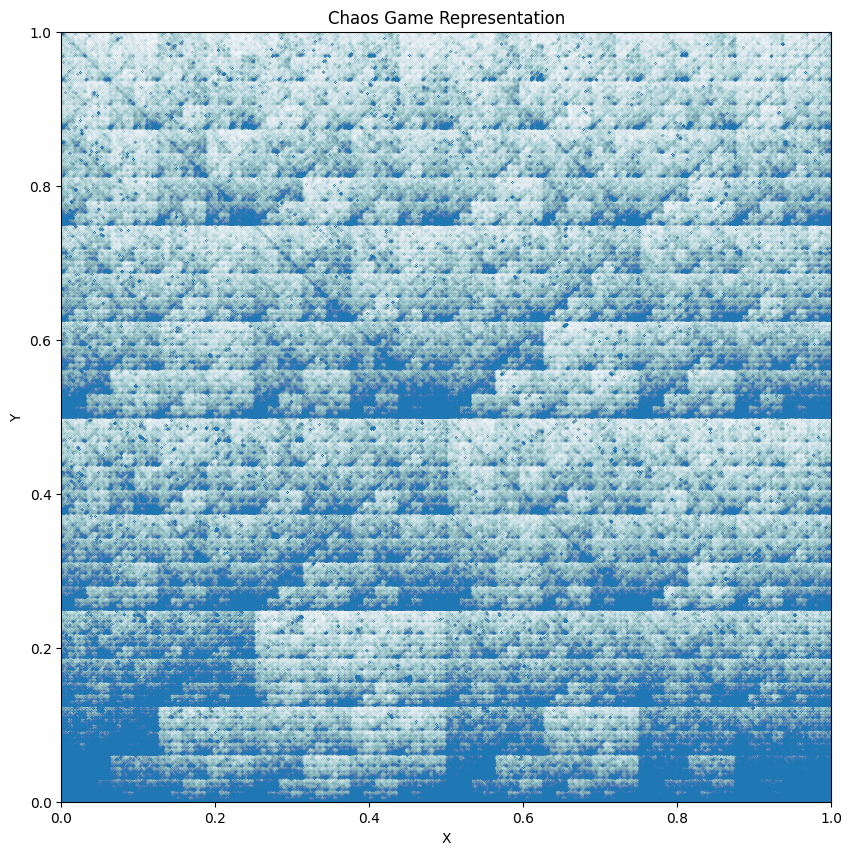

In [ ]:
[x_values, y_values] = cgr_generator.generate_only_cgr(graph=True)

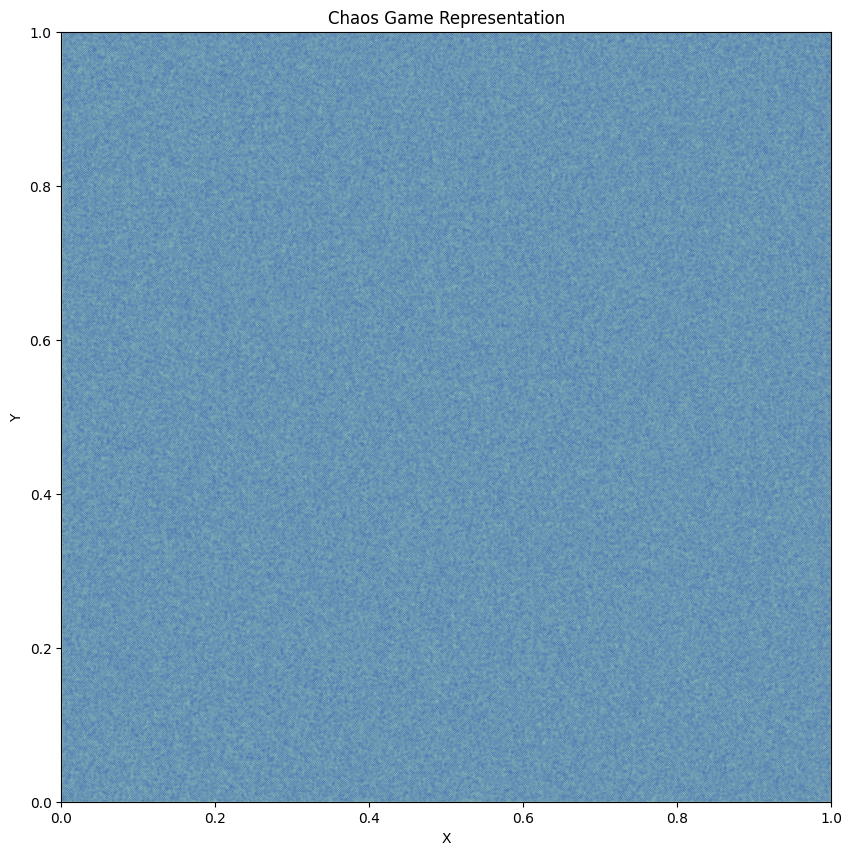

In [ ]:
[random_x_values, random_y_values] = random_cgr_generator.generate_only_cgr(graph=True)

### CGR counting

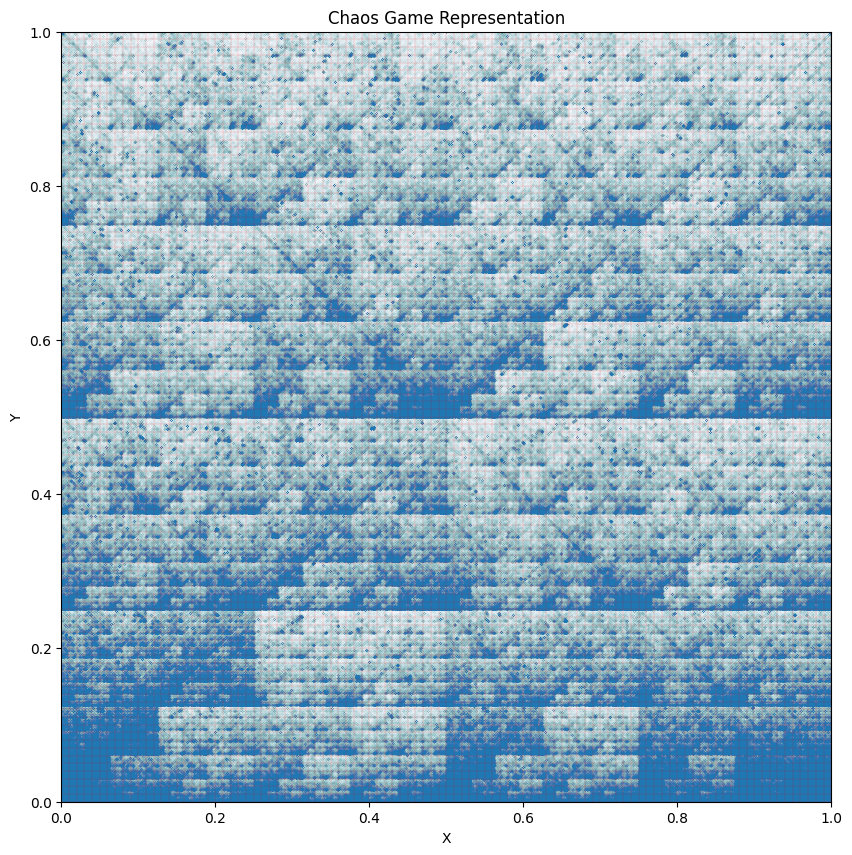

In [ ]:
mi_grid = cgr_generator.generate_cgr_counting_grid_cells(graph=True, epsilon=0.01)

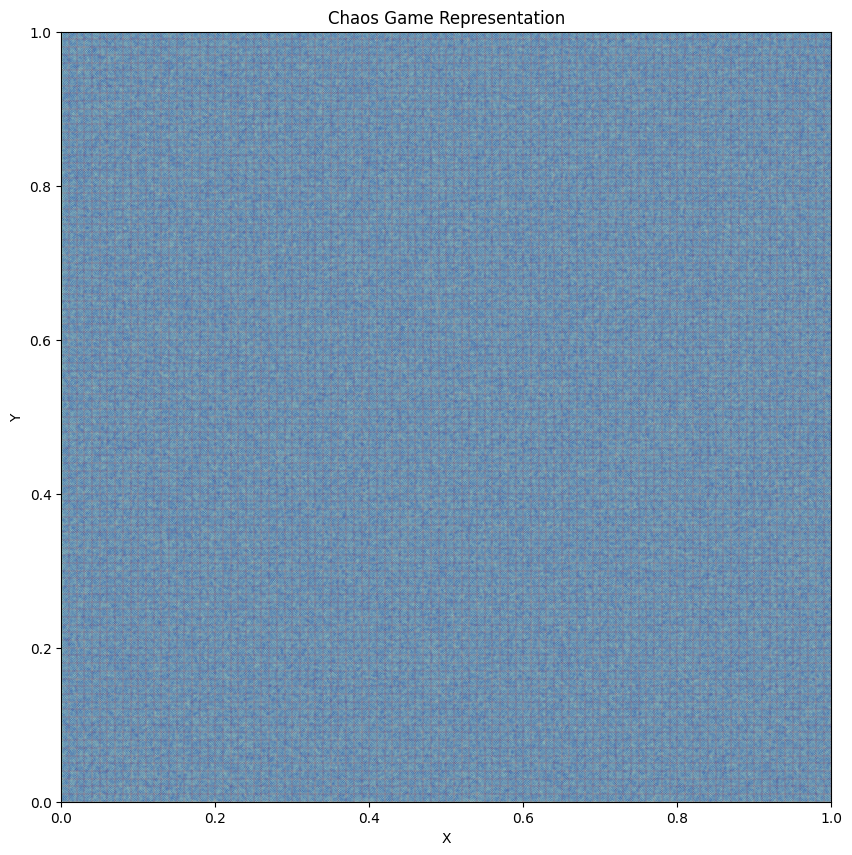

In [ ]:
random_mi_grid = random_cgr_generator.generate_cgr_counting_grid_cells(graph=True, epsilon=0.01)

### 3D CGR

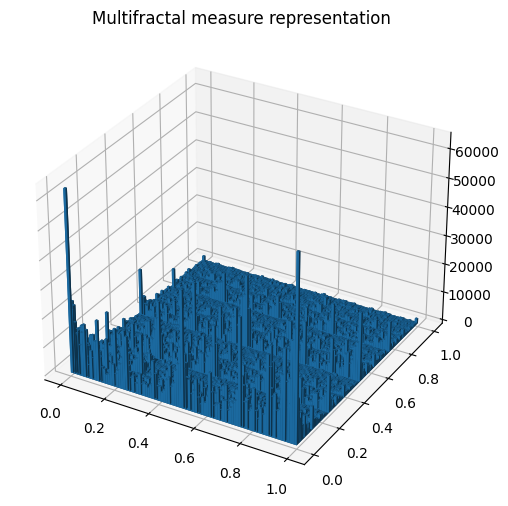

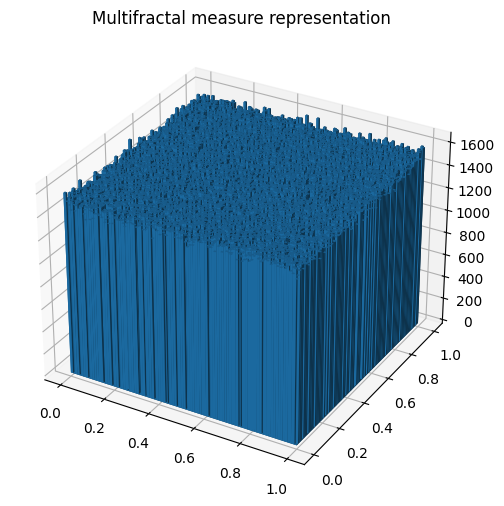

In [ ]:
Graphs.graph_3d_cgr(count_matrix=mi_grid)
Graphs.graph_3d_cgr(count_matrix=random_mi_grid)

## Multifractal analysis - MFA

In [ ]:
mfa = MFA(mi_grid)
mfa.multifractal_discrimination_analysis(epsilon=0.01)

{'q_values': array([-20, -19, -18, -17, -16, -15, -14, -13, -12, -11, -10,  -9,  -8,
         -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,   2,   3,   4,   5,
          6,   7,   8,   9,  10,  11,  12,  13,  14,  15,  16,  17,  18,
         19,  20]),
 'Dq_values': array([2.38530991, 2.38032411, 2.37488093, 2.3689173 , 2.36235874,
        2.35511685, 2.34708631, 2.33814119, 2.32813058, 2.31687349,
        2.30415329, 2.28971213, 2.27324676, 2.25440732, 2.23280101,
        2.20799702, 2.17951015, 2.14669422, 2.10838039, 2.06185857,
        2.        , 1.9044524 , 1.75631729, 1.60607181, 1.50194156,
        1.43460695, 1.38941515, 1.3575446 , 1.33405919, 1.31611616,
        1.30199927, 1.29062265, 1.28126996, 1.27345138, 1.26682158,
        1.26113055, 1.2561932 , 1.25186969, 1.24805256, 1.24465788,
        1.24161925]),
 'tau_q_values': array([-5.00915080e+01, -4.76064823e+01, -4.51227376e+01, -4.26405113e+01,
        -4.01600985e+01, -3.76818696e+01, -3.52062946e+01, -3.27339766e+01,
  

In [ ]:
random_mfa = MFA(random_mi_grid)
random_mfa.multifractal_discrimination_analysis(epsilon=0.01)

{'q_values': array([-20, -19, -18, -17, -16, -15, -14, -13, -12, -11, -10,  -9,  -8,
         -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,   2,   3,   4,   5,
          6,   7,   8,   9,  10,  11,  12,  13,  14,  15,  16,  17,  18,
         19,  20]),
 'Dq_values': array([2.00143514, 2.00136281, 2.00129053, 2.0012183 , 2.00114612,
        2.001074  , 2.00100193, 2.00092992, 2.00085798, 2.00078609,
        2.00071427, 2.00064252, 2.00057084, 2.00049922, 2.00042768,
        2.00035621, 2.00028482, 2.0002135 , 2.00014225, 2.00007109,
        2.        , 1.99992899, 1.99985807, 1.99978722, 1.99971646,
        1.99964578, 1.99957519, 1.99950468, 1.99943425, 1.99936391,
        1.99929366, 1.99922349, 1.99915341, 1.99908341, 1.9990135 ,
        1.99894367, 1.99887394, 1.99880428, 1.99873472, 1.99866524,
        1.99859584]),
 'tau_q_values': array([-4.20301380e+01, -4.00272563e+01, -3.80245201e+01, -3.60219294e+01,
        -3.40194841e+01, -3.20171840e+01, -3.00150290e+01, -2.80130189e+01,
  

### Tab values: q - Dq - t(q)

In [ ]:
mfa.print_tab_values()

q	Dq	τ(q)
-20	2.385309906725647	-50.09150804123858
-19	2.3803241127726844	-47.606482255453685
-18	2.374880926298415	-45.12273759966988
-17	2.368917296967153	-42.640511345408754
-16	2.362358735586377	-40.16009850496841
-15	2.355116846899574	-37.68186955039318
-14	2.3470863061152345	-35.206294591728515
-13	2.338141187167342	-32.73397662034279
-12	2.328130577153209	-30.265697502991717
-11	2.316873491082505	-27.80248189299006
-10	2.304153285224507	-25.345686137469578
-9	2.2897121348612073	-22.897121348612075
-8	2.2732467620312327	-20.459220858281093
-7	2.2544073161323372	-18.035258529058698
-6	2.2328010143913537	-15.629607100739475
-5	2.20799702049332	-13.247982122959922
-4	2.1795101464054354	-10.897550732027177
-3	2.1466942204630004	-8.586776881852002
-2	2.108380393269533	-6.325141179808599
-1	2.0618585664719515	-4.123717132943903
0	2.0000000000000004	-2.0000000000000004
1	1.9044523971374612	-1.9044523961350414e-07
2	1.756317289226899	1.756317289226899
3	1.6060718105516478	3.2121436211032

### Degree of multifractality (DDq)

In [ ]:
mfa.print_degree_of_multifractality()
random_mfa.print_degree_of_multifractality()

Degree of Multifractality (DDq): 1.1436906564490343
Degree of Multifractality (DDq): 0.0028393055160229608


### Multifractal spectrum (Dq vs q)

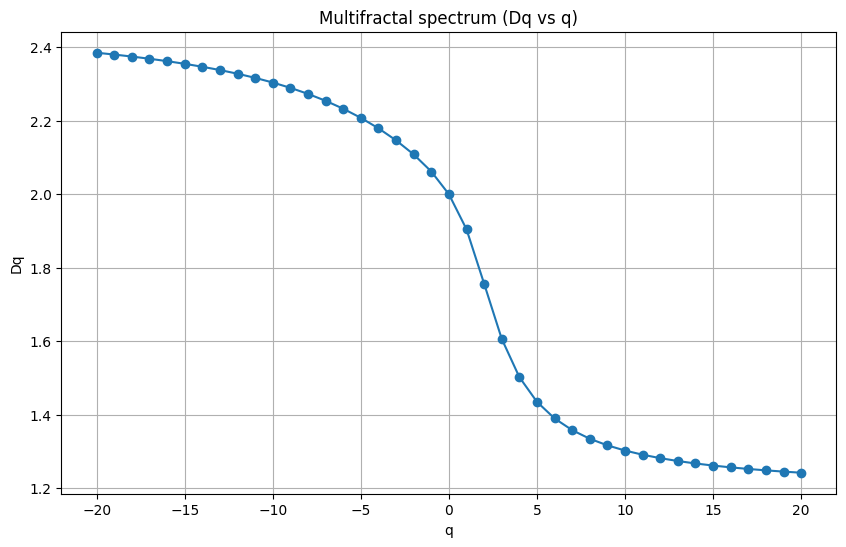

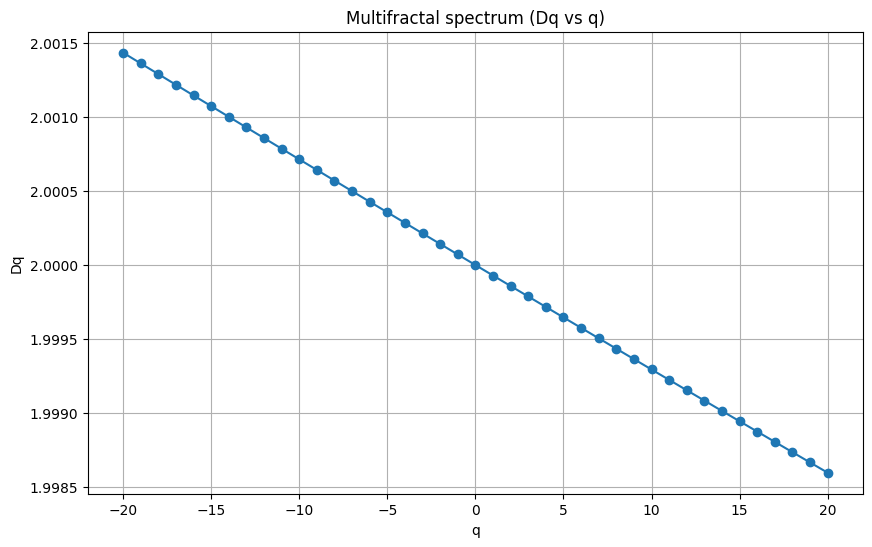

In [ ]:
mfa.graph_multifractal_spectrum()
random_mfa.graph_multifractal_spectrum()

### Correlation exponent ( t(q) vs q)

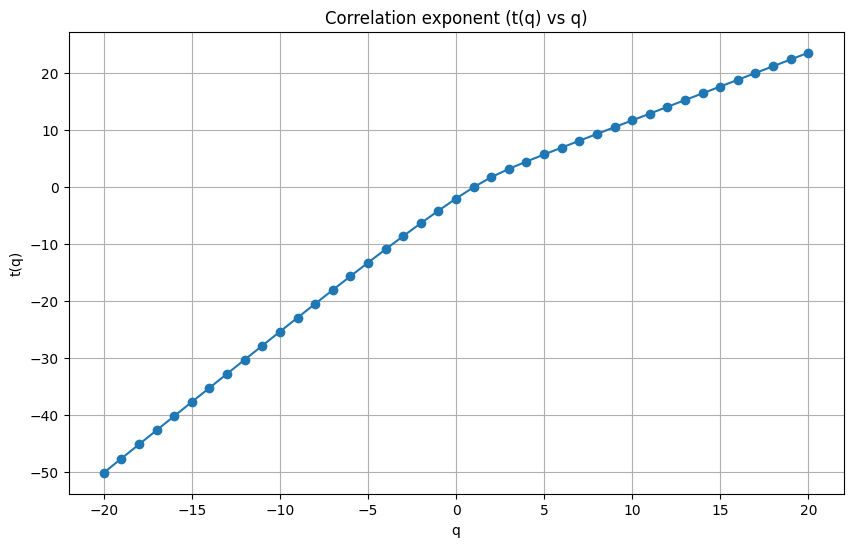

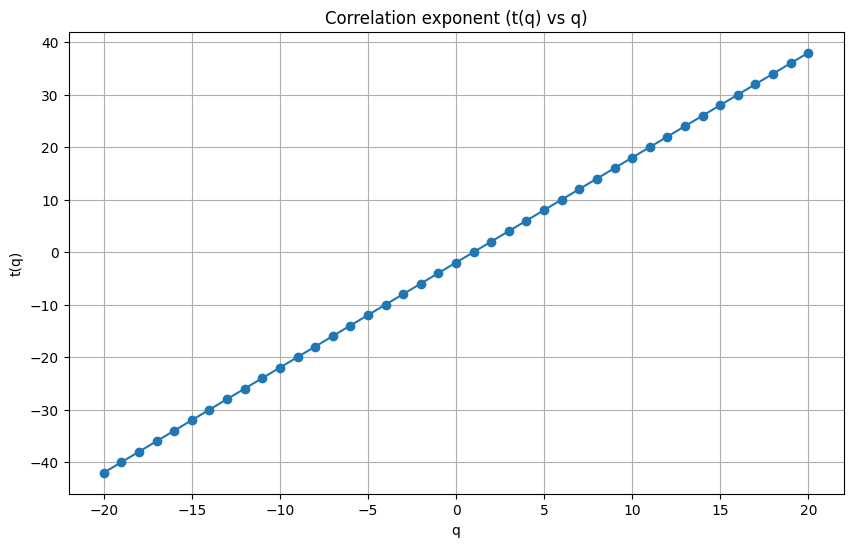

In [ ]:
mfa.graph_correlation_exponent()
random_mfa.graph_correlation_exponent()

## Momentums method and Partition Function (NOT WORKING)

### Partition Function (PF)

In [ ]:
# IT RUNS BUT GRAPH IS A HORIZONTAL LINE
"""
def partition_function():

  # Define la función para calcular log Zq(e) para un valor específico de q y e
  def calculate_log_Zq(mi_grid, q, e):
      Zq = np.sum(np.power(mi_grid.astype(float), q))
      print(Zq)
      return np.log(Zq)

  # Valores de q para los cuales deseas calcular log Zq(e)
  q_values = [1]

  # Valores de e para los cuales deseas calcular log Zq(e)
  e_values = [0.01, 0.02, 0.05, 0.1]

  # Lista para almacenar los resultados de log Zq(e) para cada combinación de q y e
  log_Zq_values = []

  # Calcular log Zq(e) para cada valor de q y e
  for q in q_values:
      log_Zq_row = []
      for e in e_values:
          # Calcula la función de partición log Zq(e) para el valor actual de q y e
          log_Zq = calculate_log_Zq(mi_grid, q, e)
          log_Zq_row.append(log_Zq)
      log_Zq_values.append(log_Zq_row)

  # Grafica log Zq(e) para cada valor de q
  plt.figure(figsize=(10, 8))
  for i, q in enumerate(q_values):
      plt.plot(np.log(e_values), log_Zq_values[i], marker='o', label=f'q={q}')

  plt.x_label('log(e)')
  plt.y_label('log(Zq)')
  plt.title('Función de Partición log Zq(e) para diferentes valores de q')
  plt.legend()
  plt.grid(True)
  plt.show()

partition_function()
"""

"\ndef partition_function():\n\n  # Define la función para calcular log Zq(e) para un valor específico de q y e\n  def calculate_log_Zq(mi_grid, q, e):\n      Zq = np.sum(np.power(mi_grid.astype(float), q))\n      print(Zq)\n      return np.log(Zq)\n\n  # Valores de q para los cuales deseas calcular log Zq(e)\n  q_values = [1]\n\n  # Valores de e para los cuales deseas calcular log Zq(e)\n  e_values = [0.01, 0.02, 0.05, 0.1]\n\n  # Lista para almacenar los resultados de log Zq(e) para cada combinación de q y e\n  log_Zq_values = []\n\n  # Calcular log Zq(e) para cada valor de q y e\n  for q in q_values:\n      log_Zq_row = []\n      for e in e_values:\n          # Calcula la función de partición log Zq(e) para el valor actual de q y e\n          log_Zq = calculate_log_Zq(mi_grid, q, e)\n          log_Zq_row.append(log_Zq)\n      log_Zq_values.append(log_Zq_row)\n\n  # Grafica log Zq(e) para cada valor de q\n  plt.figure(figsize=(10, 8))\n  for i, q in enumerate(q_values):\n      plt.pl

### Multifractal analysis

In [ ]:
# IMPLEMENTED IN THE MFA CLASS
def multifractal_analysis(mi_grid, epsilon):
  # Example q values
  q_values = np.arange(-20, 21)

  # mi_grid reshaped
  mi_grid_flattened = mi_grid.reshape(-1)
 # print("mi_grid_flattened:", mi_grid_flattened)

  #M0
  total_fractal_points = sum(mi_grid_flattened)
  print('total points', total_fractal_points)
  #print("total_fractal_points:", total_fractal_points)

  # sum_term


  # Calculate Dq and τ(q) values
  Dq_values = np.array([])
  tau_q_values = []

  for q in q_values:
      if q == 1:
        q = 0.9999999

      sum_term = sum(np.power(mi_grid_flattened / total_fractal_points, q))
      numerator = np.log(sum_term)
      denominator = np.log(epsilon)

      Dq = (1 / (q - 1)) * (numerator / denominator)

      Dq_values = np.append(Dq_values, [Dq])

      tau_q = (q - 1) * Dq
      tau_q_values.append(tau_q)

  print(Dq_values)
  # Print or visualize the calculated Dq and τ(q) values
  print("q\tDq\tτ(q)")
  for q, Dq, tau_q in zip(q_values, Dq_values, tau_q_values):
      print(f"{q}\t{Dq}\t{tau_q}")

  # Find the maximum and minimum Dq values
  Dqmax = max(Dq_values)
  Dqmin = min(Dq_values)

  # Calculate the degree of multifractality (DDq)
  DDq = Dqmax - Dqmin

  # Print the DDq value
  print(f"Degree of Multifractality (DDq): {DDq}")

  return {
      'q_values': q_values,
      'Dq_values': Dq_values,
      'tau_q_values': tau_q_values,
      'DDq': DDq
  }



### Practical use

In [ ]:
# IT RUNS, BUT IT DOESN'T MAKE SENSE. CHECK AGAIN (UNDERSTAND THEORETICAL FORMULA FIRSTLY)
def practical_use(mi_grid, epsilon):
  q_values = np.arange(-20, 21)
  # mi_grid reshaped
  mi_grid_flattened = mi_grid.reshape(-1)
 # print("mi_grid_flattened:", mi_grid_flattened)

  #M0
  total_fractal_points = sum(mi_grid_flattened)
  #print("total_fractal_points:", total_fractal_points)

  # sum_term


  # Calculate Dq and τ(q) values
  y_values = []
  x_values = []
  tau_q_values = []

  # Calculate ln(Mi^q) for each q value
  ln_mi_q_values = np.array([np.log(np.power(mi_grid_flattened.astype(float), q)) for q in q_values])
  """
  ln_mi_q_values:
  Una fila por cada valor q, y una columna por cada elemento de la lista mi_grid_flattened (matriz mi_grid como lista)
  Ejemplo:
  ln_mi_q_values[12,3] tiene el valor equivalente de hacer la operación con q_values[12] y mi_grid_flattened[3],
  más exactamente -> np.log(np.power(float(mi_grid_flattened[3]), q_values[12]))

  len q: 41
  len mi_grid: 10000
  shape of ln_mi_q: (41, 10000)
  """

  # Calculate (q - 1)ln(ε) for each q value
  q_minus_1_ln_epsilon = np.array([(q - 1) * np.log(epsilon) for q in q_values])

  """
  q_minus_1_ln_epsilon:
  shape: (41,)

  """
  return None

  for q in q_values:
      lnM = np.log(np.power(mi_grid_flattened.astype(float),q))
      x_value = (q - 1)*np.log(epsilon)
      x_values.append(x_value)
      y_values.append(lnM)

  return {
      'x_values': x_values,
      'y_values': y_values,
  }


      #tau_q = (q - 1) * Dq
      #tau_q_values.append(tau_q)

  # Print or visualize the calculated Dq and τ(q) values
"""  print("q\tDq\tτ(q)")
  for q, Dq, tau_q in zip(q_values, y_values, tau_q_values):
      print(f"{q}\t{Dq}\t{tau_q}")"""

  # Find the maximum and minimum Dq values
""" Dqmax = max(y_values)
      Dqmin = min(y_values)"""

  # Calculate the degree of multifractality (DDq)
  #DDq = Dqmax - Dqmin

  # Print the DDq value
  #print(f"Degree of Multifractality (DDq): {DDq}")





' Dqmax = max(y_values)\n      Dqmin = min(y_values)'

In [ ]:
epsilon=0.01
result_seq = multifractal_analysis(mi_grid, epsilon)
print(result_seq)
#graph_one(result_seq['q_values'], result_seq['Dq_values'], 'q', 'Dq', 'Dq vs q')

total points 15072434
[2.38530991 2.38032411 2.37488093 2.3689173  2.36235874 2.35511685
 2.34708631 2.33814119 2.32813058 2.31687349 2.30415329 2.28971213
 2.27324676 2.25440732 2.23280101 2.20799702 2.17951015 2.14669422
 2.10838039 2.06185857 2.         1.90445241 1.75631729 1.60607181
 1.50194156 1.43460695 1.38941515 1.3575446  1.33405919 1.31611616
 1.30199927 1.29062265 1.28126996 1.27345138 1.26682158 1.26113055
 1.2561932  1.25186969 1.24805256 1.24465788 1.24161925]
q	Dq	τ(q)
-20	2.385309906725647	-50.09150804123858
-19	2.3803241127726844	-47.606482255453685
-18	2.374880926298415	-45.12273759966988
-17	2.368917296967153	-42.640511345408754
-16	2.362358735586377	-40.16009850496841
-15	2.3551168468995733	-37.68186955039317
-14	2.3470863061152345	-35.206294591728515
-13	2.338141187167342	-32.73397662034279
-12	2.328130577153209	-30.265697502991717
-11	2.316873491082505	-27.80248189299006
-10	2.304153285224507	-25.345686137469578
-9	2.2897121348612073	-22.897121348612075
-8	2.273

# By chromosome region


## Divide sequence in regions

In [ ]:
region_sequence = ThreePartRegionSequence(dna_sequence.get_sequence())
[left, center, right] = region_sequence.get_regions()

In [ ]:
print("The regions' sizes are:", region_sequence.get_regions_sizes())
print("The number of regions is:", region_sequence.get_regions_number())

The regions' sizes are: [5024144 5024144 5024146]
The number of regions is: 3


## Generate CGR

In [ ]:
left_cgr = CGR(sequence=left)
center_cgr = CGR(sequence=center)
right_cgr = CGR(sequence=right)

### CGR counting

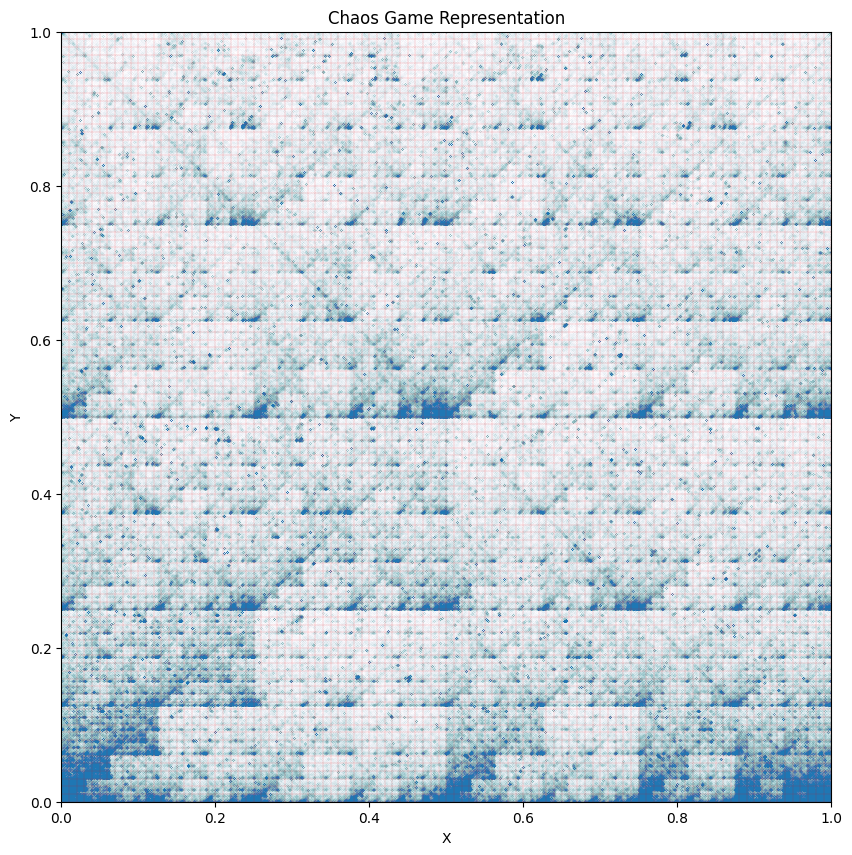

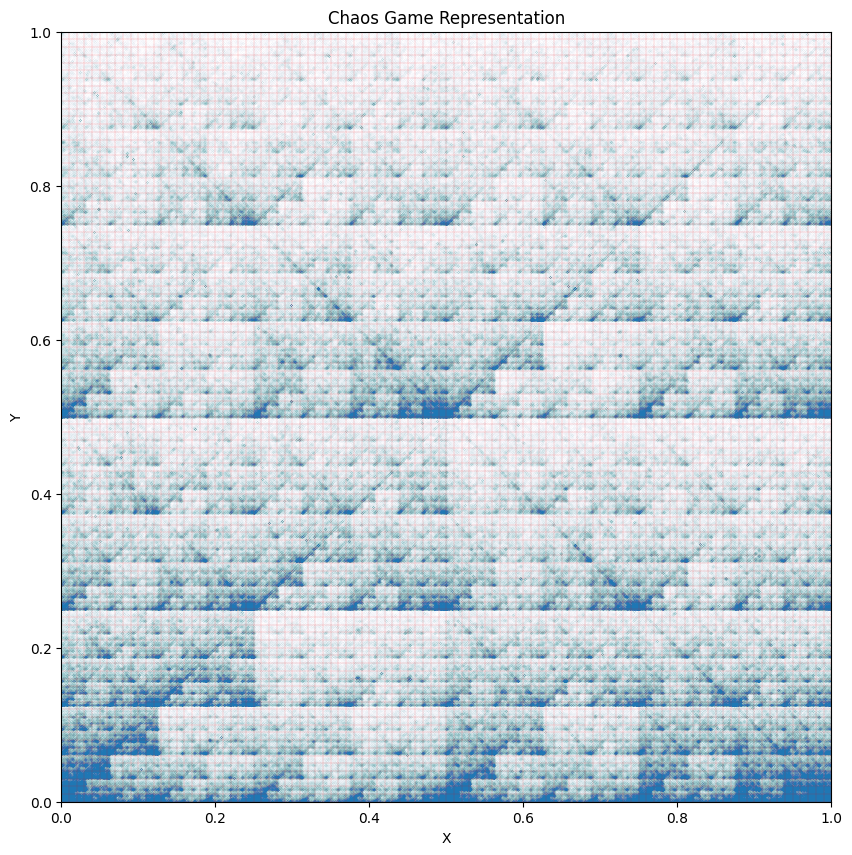

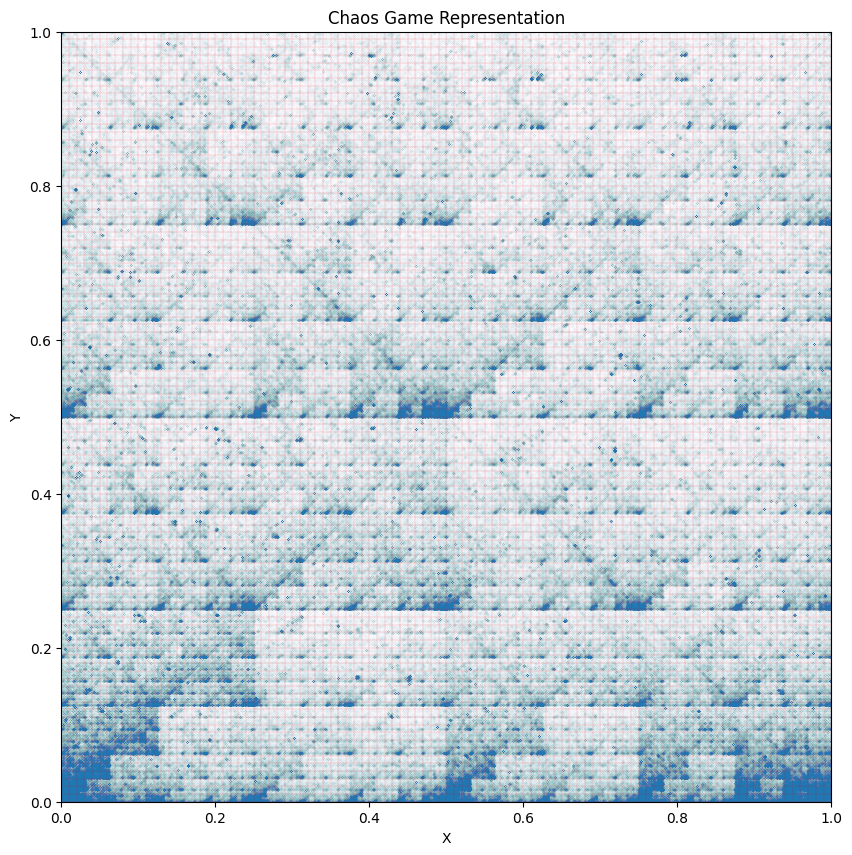

In [ ]:
# Generate chaos game representation and calculate Mi values

mi_grid_left = left_cgr.generate_cgr_counting_grid_cells(graph=True, epsilon=0.01)
mi_grid_center = center_cgr.generate_cgr_counting_grid_cells(graph=True, epsilon=0.01)
mi_grid_right = right_cgr.generate_cgr_counting_grid_cells(graph=True, epsilon=0.01)

### 3D CGR

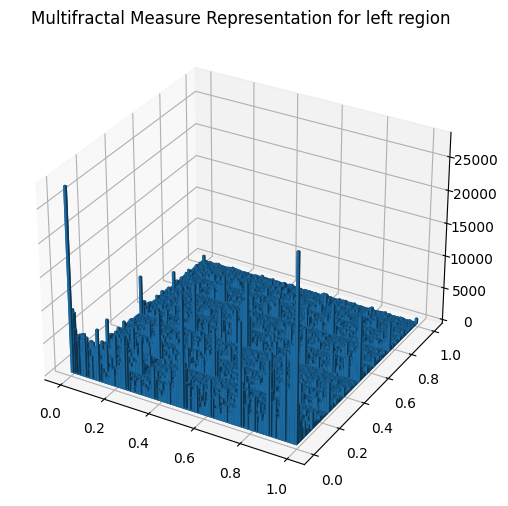

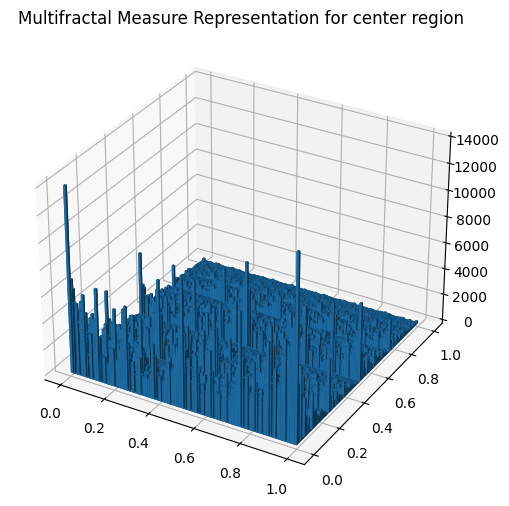

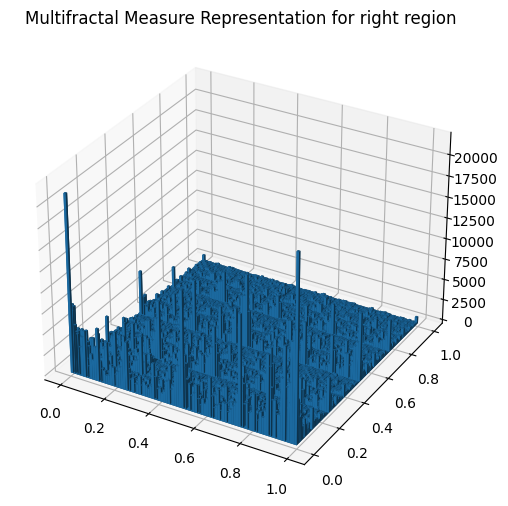

In [ ]:
Graphs.graph_3d_cgr(count_matrix=mi_grid_left, title="Multifractal Measure Representation for left region")
Graphs.graph_3d_cgr(count_matrix=mi_grid_center, title="Multifractal Measure Representation for center region")
Graphs.graph_3d_cgr(count_matrix=mi_grid_right, title="Multifractal Measure Representation for right region")

## Multifractal analysis - MFA

### Left region

Degree of Multifractality (DDq): 1.180380222812922


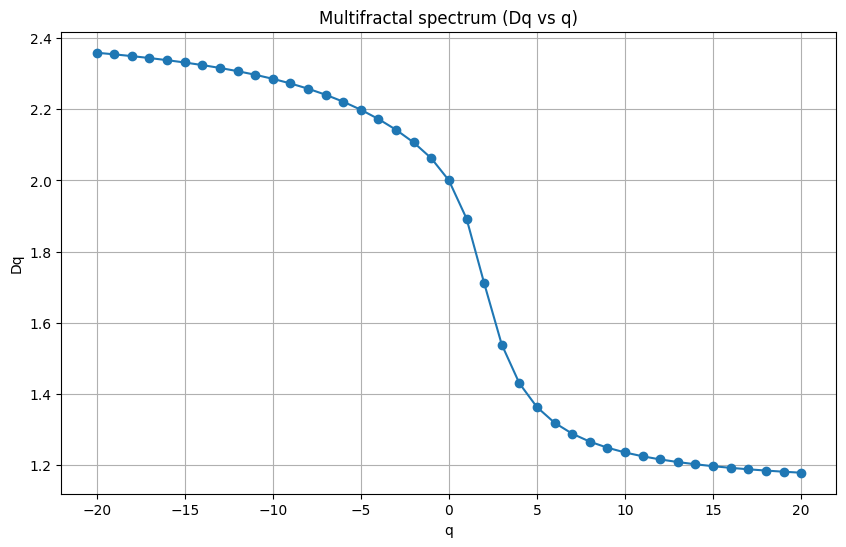

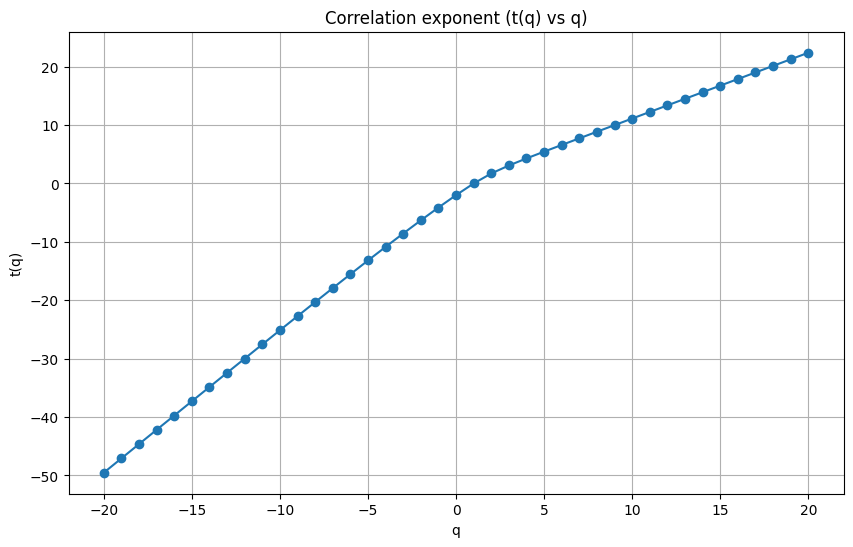

In [ ]:
left_mfa = MFA(mi_grid=mi_grid_left)
result_left = left_mfa.multifractal_discrimination_analysis(epsilon=0.01)
left_mfa.print_degree_of_multifractality()
left_mfa.graph_multifractal_spectrum()
left_mfa.graph_correlation_exponent()

### Center region

Degree of Multifractality (DDq): 1.1706909407786283


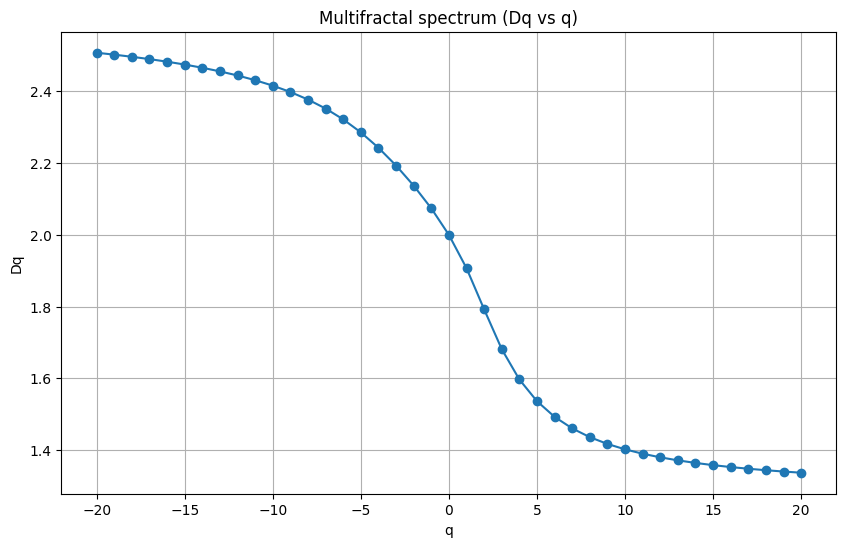

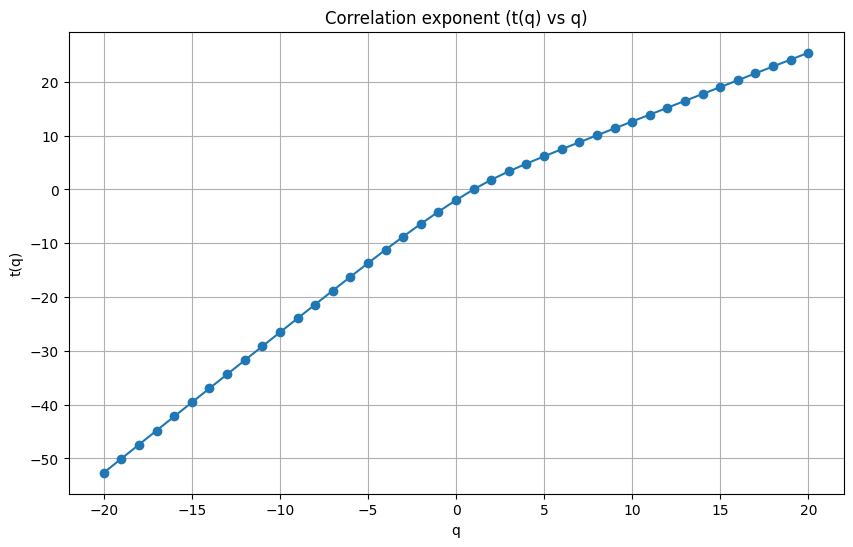

In [ ]:
center_mfa = MFA(mi_grid=mi_grid_center)
result_center = center_mfa.multifractal_discrimination_analysis(epsilon=0.01)
center_mfa.print_degree_of_multifractality()
center_mfa.graph_multifractal_spectrum()
center_mfa.graph_correlation_exponent()

### Right region

Degree of Multifractality (DDq): 1.121543537486128


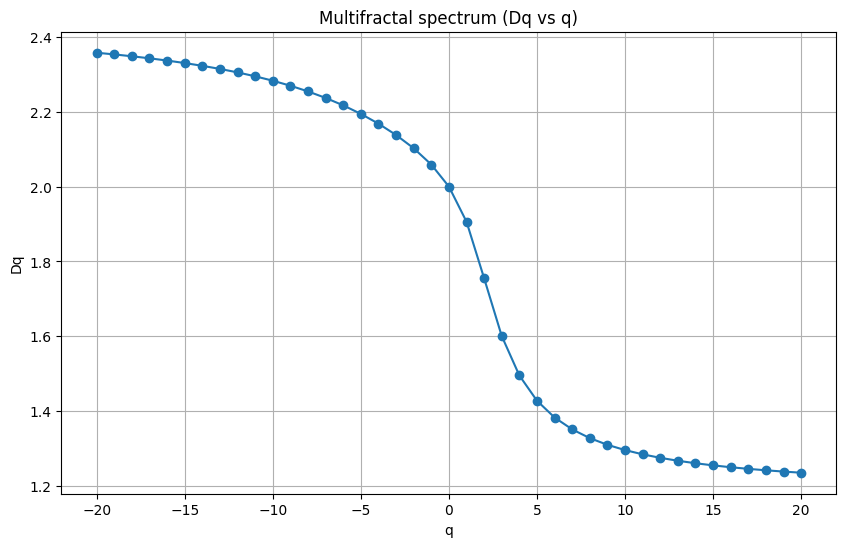

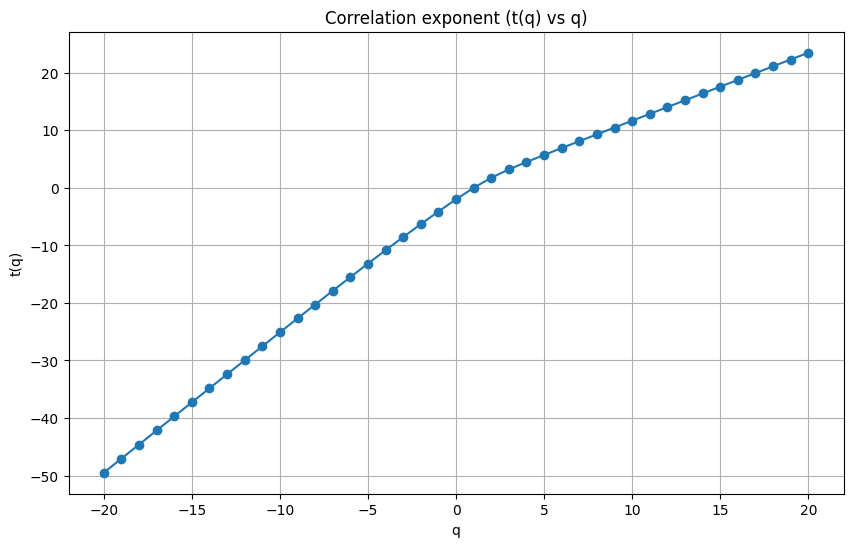

In [ ]:
right_mfa = MFA(mi_grid=mi_grid_right)
result_right = right_mfa.multifractal_discrimination_analysis(epsilon=0.01)
right_mfa.print_degree_of_multifractality()
right_mfa.graph_multifractal_spectrum()
right_mfa.graph_correlation_exponent()

### Graphs considering all regions

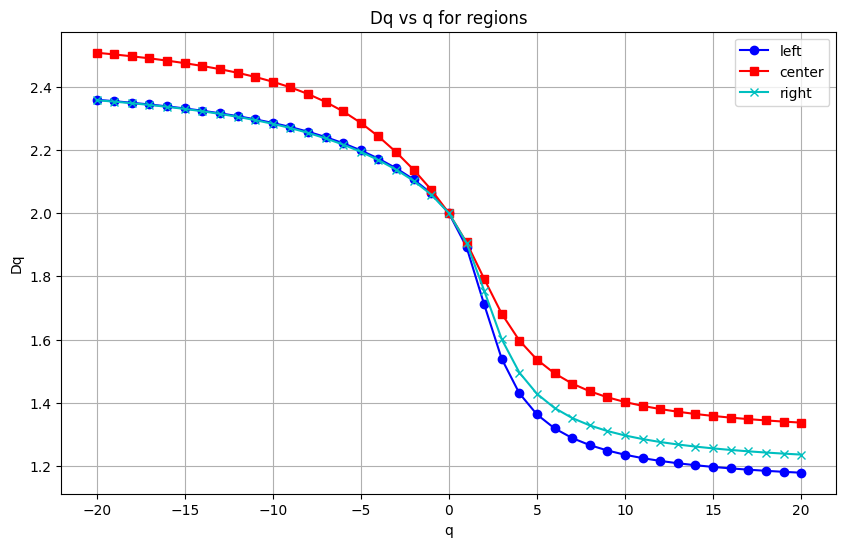

In [ ]:
Graphs.graph_many(results_array=[result_left, result_center, result_right], X='q_values', Y='Dq_values', x_label='q', y_label='Dq',
                     title='Dq vs q for regions', labels_array=['left', 'center', 'right'], linestyles_array=['-', '-', '-'],
                     markers_array=['o', 's', 'x'], colors_array=['b', 'r', 'c'])

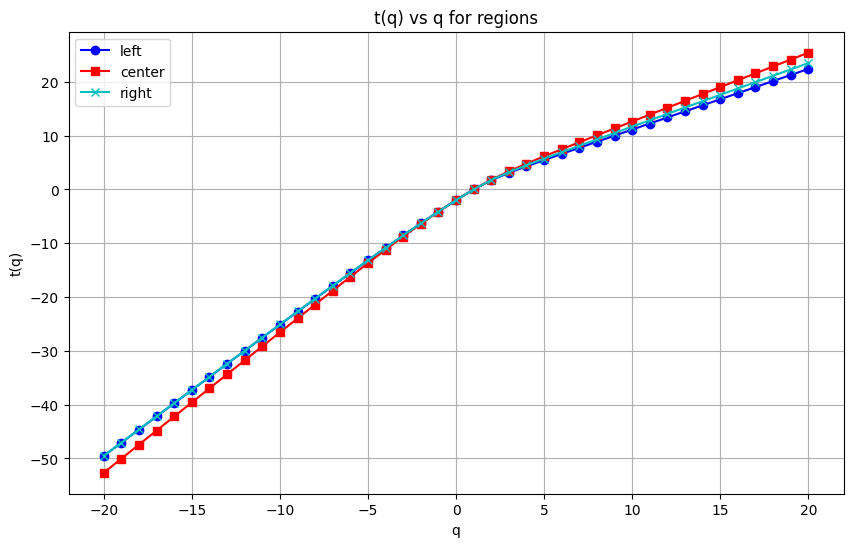

In [ ]:
Graphs.graph_many(results_array=[result_left, result_center, result_right], X='q_values', Y='tau_q_values', x_label='q', y_label='t(q)',
                     title='t(q) vs q for regions', labels_array=['left', 'center', 'right'], linestyles_array=['-', '-', '-'],
                     markers_array=['o', 's', 'x'], colors_array=['b', 'r', 'c'])

# Comparing chromosomes

## Load sequences

In [ ]:
from Bio import SeqIO


c_elegans_data = [{"path": "c_elegans_chromosome_I.fasta", "name": "chromosome_I"},
                    {"path": "c_elegans_chromosome_II.fasta", "name": "chromosome_II"},
                    {"path": "c_elegans_chromosome_III.fasta", "name": "chromosome_III"},
                    {"path": "c_elegans_chromosome_IV.fasta", "name": "chromosome_IV"},
                    {"path": "c_elegans_chromosome_V.fasta", "name": "chromosome_V"},
                    {"path": "c_elegans_chromosome_X.fasta", "name": "chromosome_X"},
                    ]

genome = Genome(chromosomes_data=c_elegans_data)
print(genome.get_genome_size())


100272607


## Generate CGR

In [ ]:
cgr_generators = [CGR()]

AttributeError: ignored

### CGR counting

In [ ]:
mi_grids = []

for generator in cgr_generators:
  mi_grids.append(generator.generate_cgr_counting_grid_cells(graph=True, epsilon=0.01))

### 3D CGR

In [ ]:
for mi_grid in mi_grids:
  Graphs.graph_3d_cgr(count_matrix=mi_grid)


## Multifractal analysis - MFA

In [ ]:
mfas = []
for mi_grid in mi_grids:
  mfas.append(MFA(mi_grid))

In [ ]:
results = []
for mfa in mfas:
  results.append(mfa.multifractal_discrimination_analysis(epsilon=0.01))

### Degree of multifractality

In [ ]:
degrees_of_multifractality = []
for mfa in mfas:
  mfa.print_degree_of_multifractality()
  degrees_of_multifractality.append(mfa.get_DDq())

In [ ]:
Graphs.graph_bars(x_array=genome.get_chromosomes_names(), y_array=degrees_of_multifractality, title="Degree of multifractality by chromosome",
                  y_label="Degree of multifractality", y_range=[1.05, 1.2])

### Graphs considering all chromosomes

In [ ]:
# make this work without creating the array
results = []
for mfa in mfas:
  results.append(mfa.get_result())
len(results)

In [ ]:
Graphs.graph_many(results_array=results, X='q_values', Y='Dq_values', x_label='q', y_label='Dq',
                     title='Dq vs q for chromosomes', labels_array=genome.get_chromosomes_names(),
                     markers_array=['o', 's', 'x', 'v', '*'], colors_array=['b', 'r', 'c', 'g', 'y'], linestyles_array=['-','-','-','-','-'])

In [ ]:
Graphs.graph_many(results_array=results, X='q_values', Y='Dq_values', x_label='q', y_label='Dq',
                     title='Dq vs q for chromosomes', labels_array=genome.get_chromosomes_names(),
                  )

In [ ]:
Graphs.graph_many(results_array=results, X='q_values', Y='tau_q_values', x_label='q', y_label='t(q)',
                     title='t(q) vs q for chromosomes', labels_array=genome.get_chromosomes_names(),
                     markers_array=['o', 's', 'x', 'v', '*'], colors_array=['b', 'r', 'c', 'g', 'y'], linestyles_array=['-','-','-','-','-'])

# All in a single execution

All in a single exec:
- Load sequences
- Just one chromosome ✅:
	- CGR
	- MFA
	- Graphs
- Just one chromosome by regions ✅:
	- CGR
	- MFA
	- Graphs
- Whole genome or organism ✅:
        Whole chromosomes
	- CGRs
	- MFAs
	- Graphs
- Chromosomes of genome divided in regions
	- CGRs
	- MFAs
	- Graphs (separate and together)
- Only regions
	- Graphs
- Whole community:
             - Whole-genome phases, for every genome.


## Load sequences

In [ ]:
from Bio import SeqIO


c_elegans_data = [{"path": "c_elegans_chromosome_I.fasta", "name": "chromosome_I"},
                    {"path": "c_elegans_chromosome_II.fasta", "name": "chromosome_II"},
                   # {"path": "c_elegans_chromosome_III.fasta", "name": "chromosome_III"},
                   # {"path": "c_elegans_chromosome_IV.fasta", "name": "chromosome_IV"},
                   # {"path": "c_elegans_chromosome_V.fasta", "name": "chromosome_V"},
                   # {"path": "c_elegans_chromosome_X.fasta", "name": "chromosome_X"},
                    ]
chromosome_I_record = SeqIO.read("c_elegans_chromosome_I.fasta", "fasta")
chromosome_I_data = {"path": "c_elegans_chromosome_I.fasta", "name": "chromosome_I"}

In [ ]:
genome = Genome(chromosomes_data=c_elegans_data, regions_number=3)
genome.get_chromosomes()[0].get_regions()[0].get_size() # for regions lookup

4479815

## Just one whole chromosome

In [ ]:
chromosome_I_sequence = Sequence(str(chromosome_I_record.seq))

In [ ]:
chromosome_I_manager = SequenceManager(sequence=chromosome_I_sequence, sequence_name='chromosome_I')

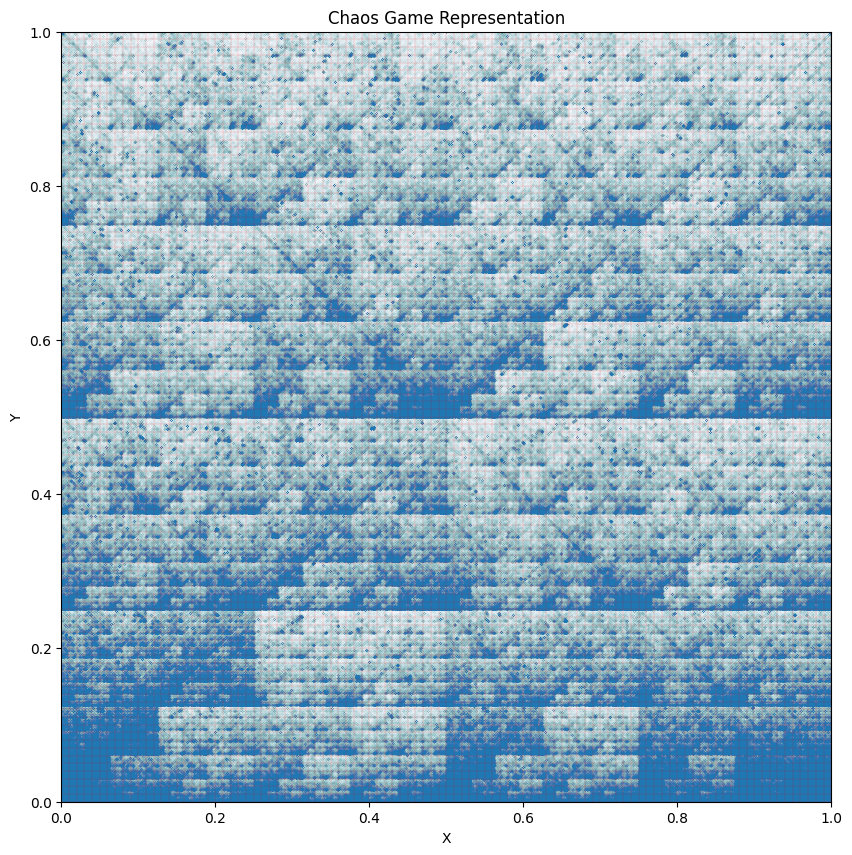

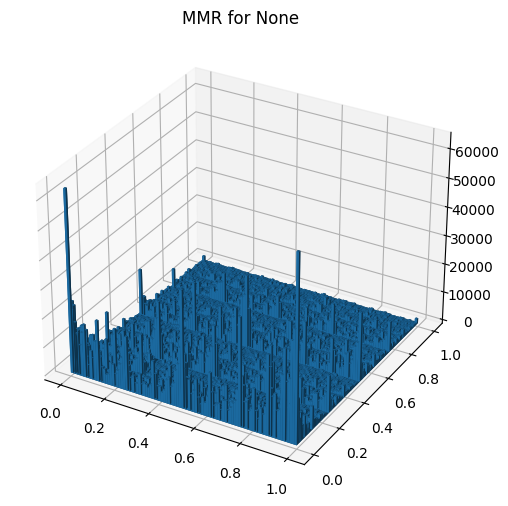

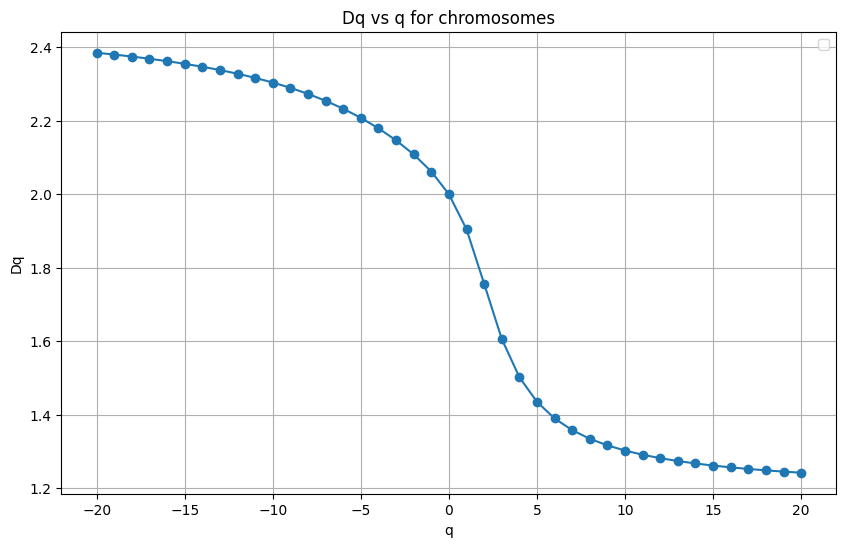

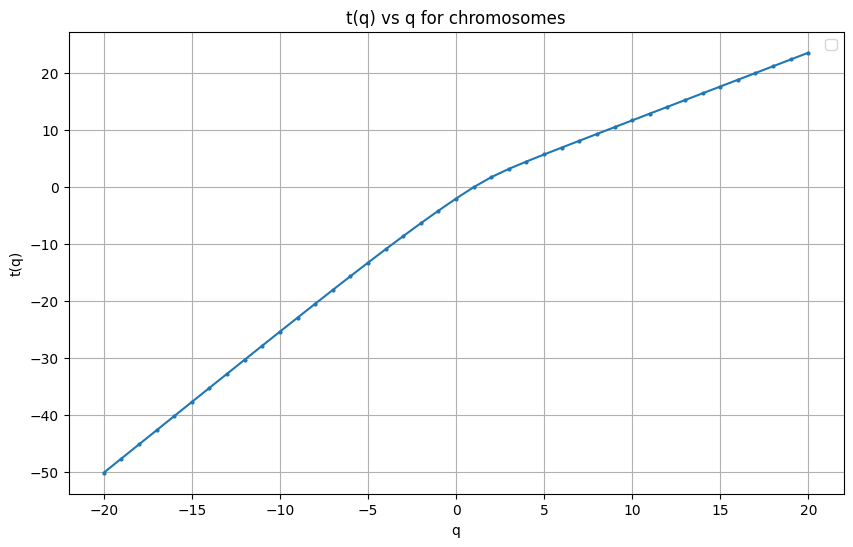

The degree of multifractality of chromosome_I is 1.1436906564490343


In [ ]:
chromosome_I_manager.calculate_and_graph(epsilon=0.01)

## Just one chromosome by regions

In [ ]:
chromosome_I_region_manager = RegionSequenceManager(sequence_data=c_elegans_data[0], sequence_name='chromosome I', regions_number=3)

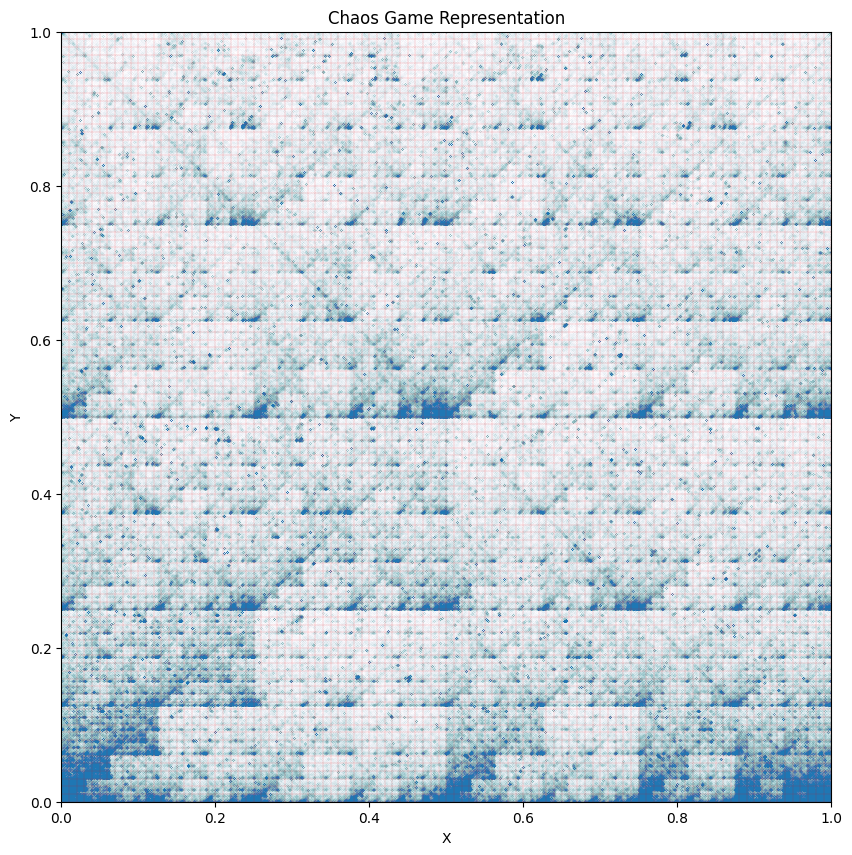

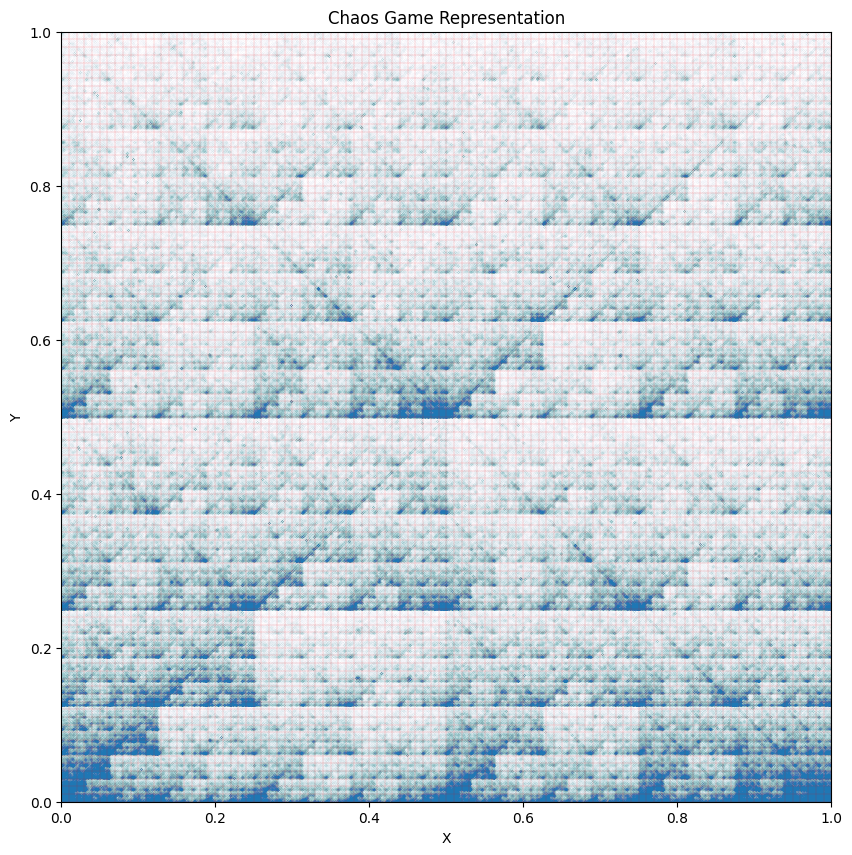

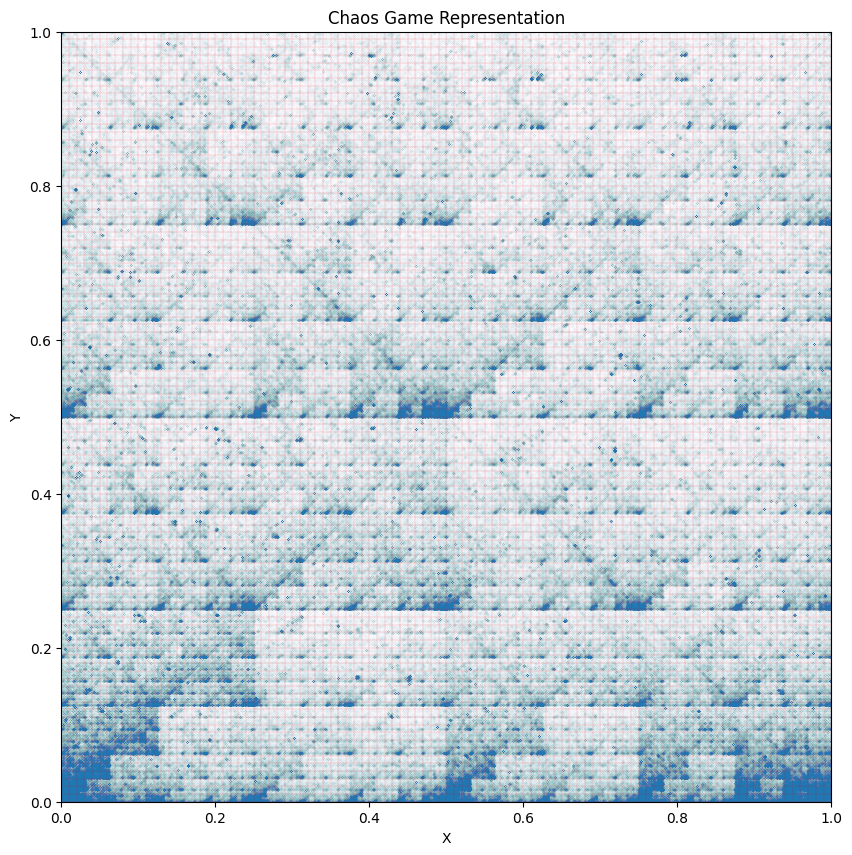

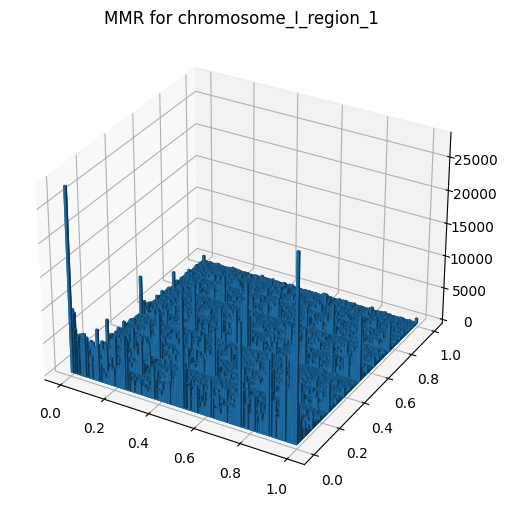

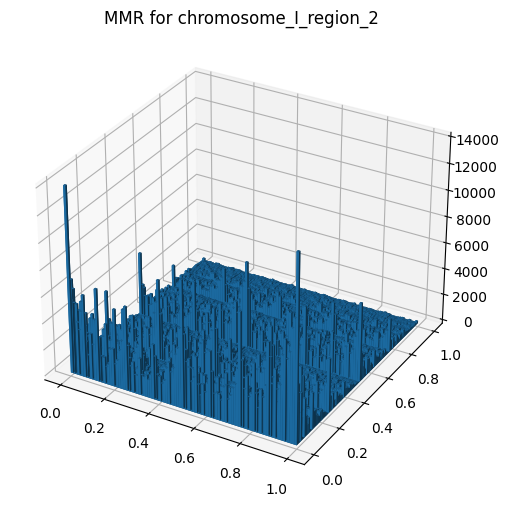

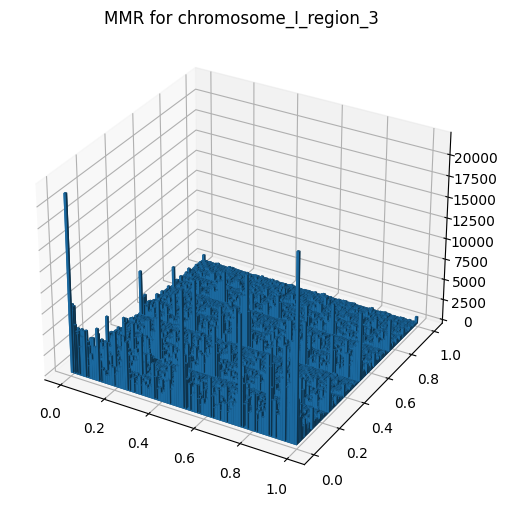

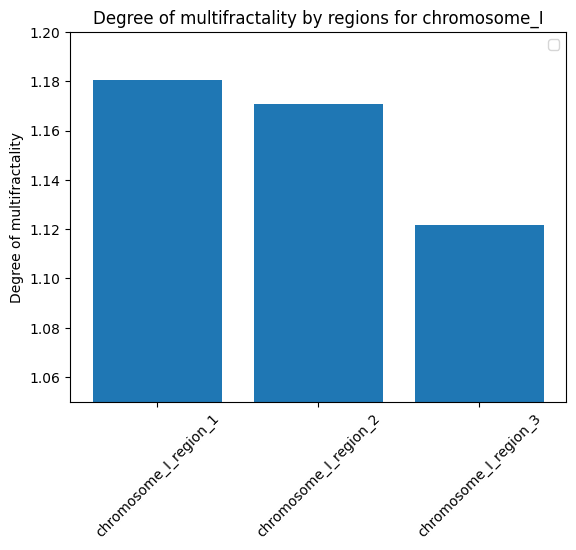

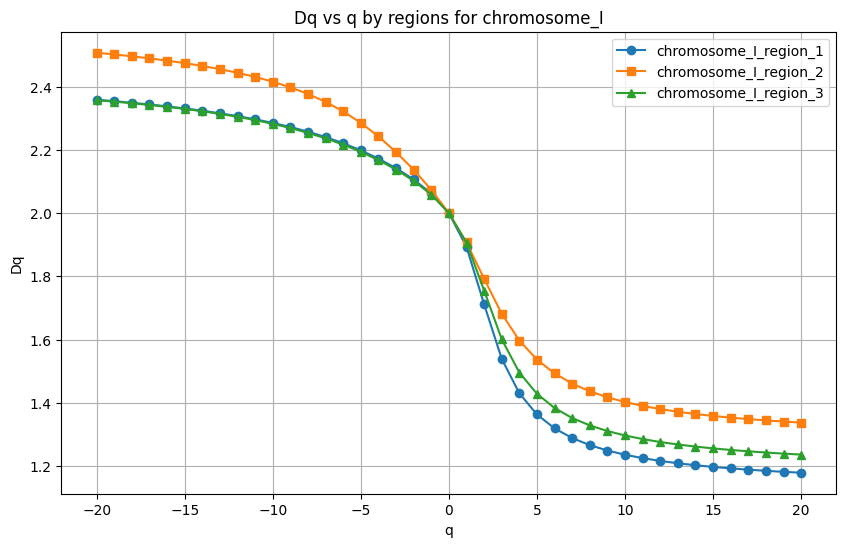

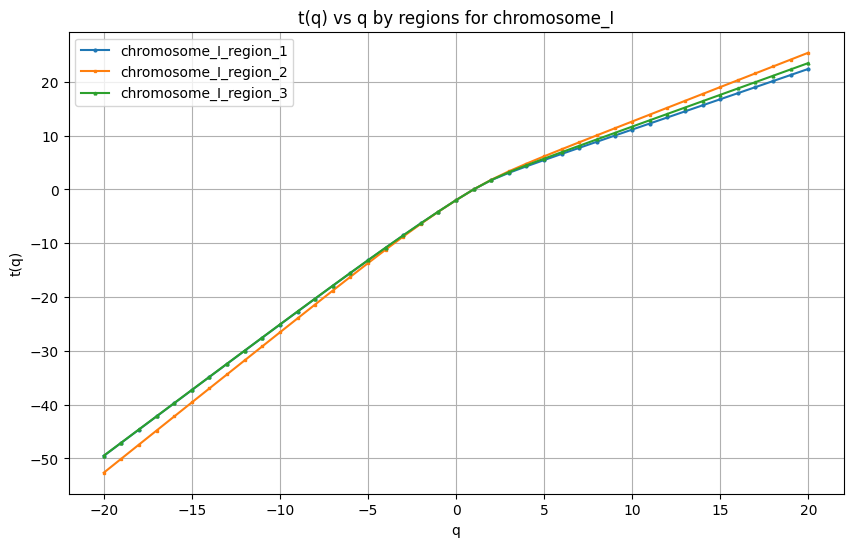

In [ ]:
chromosome_I_region_manager.calculate_and_graph(epsilon=0.01)

## Whole genome / organism

In [246]:
c_elegans_manager = GenomeManager(genome_data=c_elegans_data, organism_name="Caenorhabditis elegans")

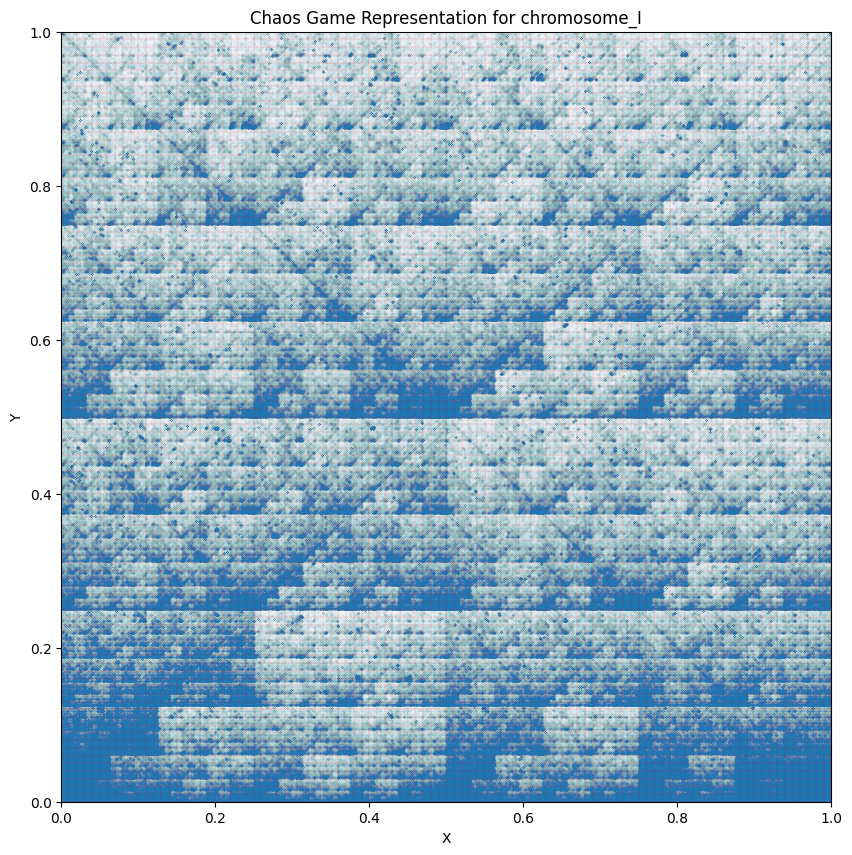

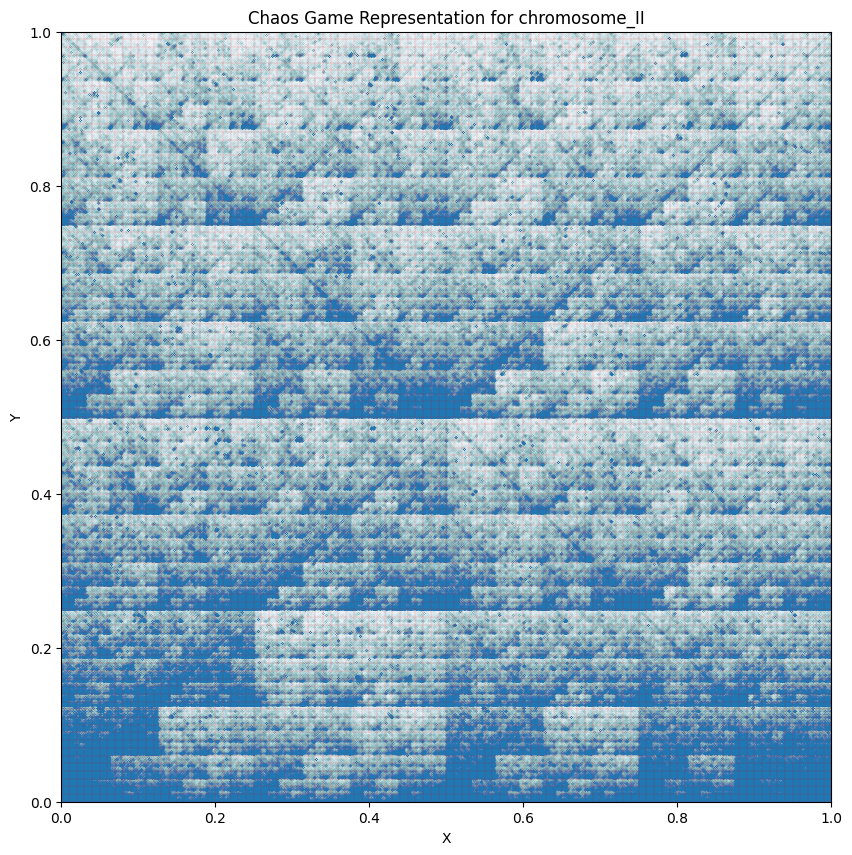

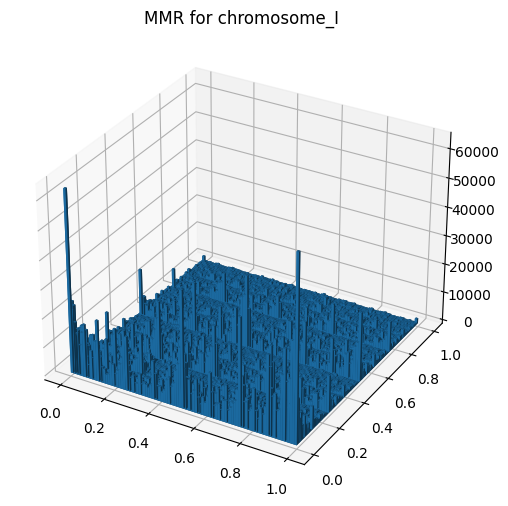

The degree of multifractality of chromosome_I is 1.1436906564490343


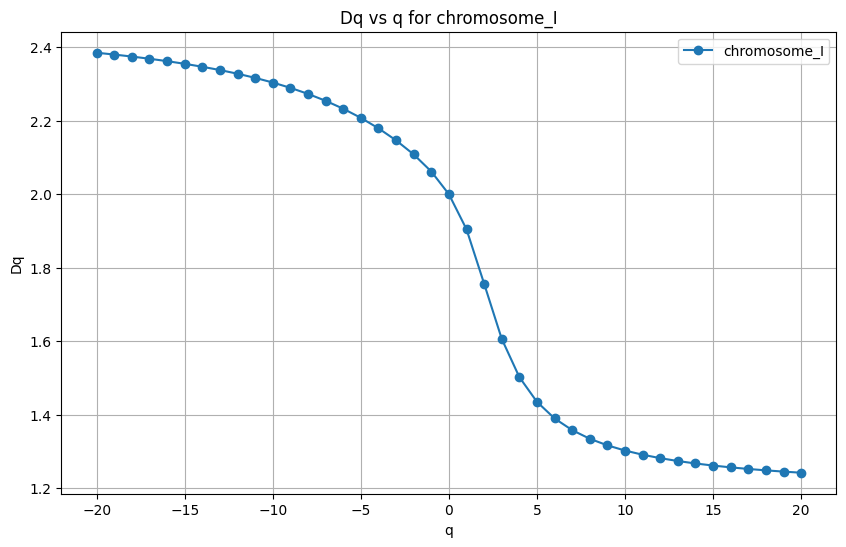

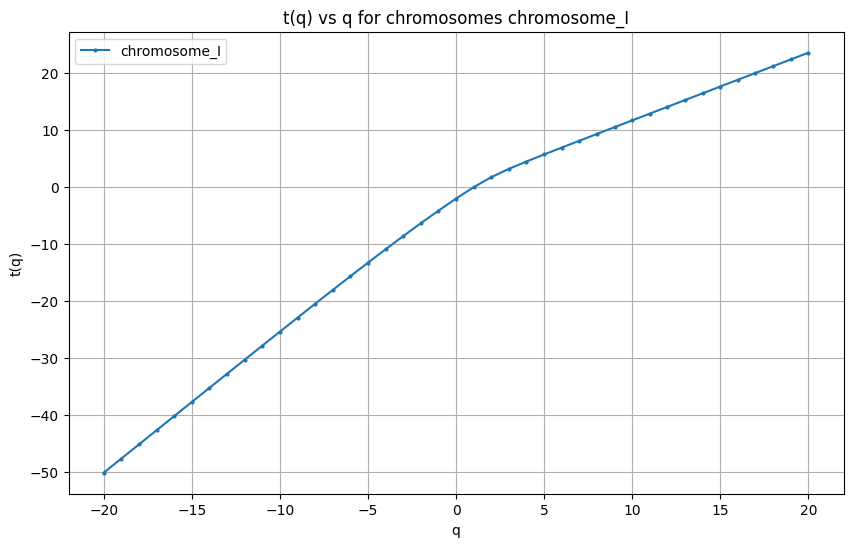

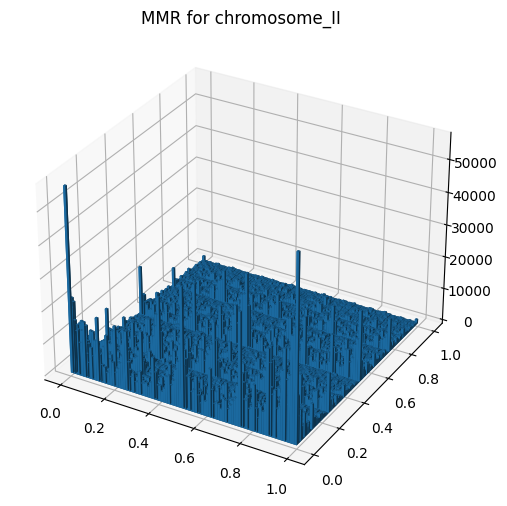

The degree of multifractality of chromosome_II is 1.1190029903027139


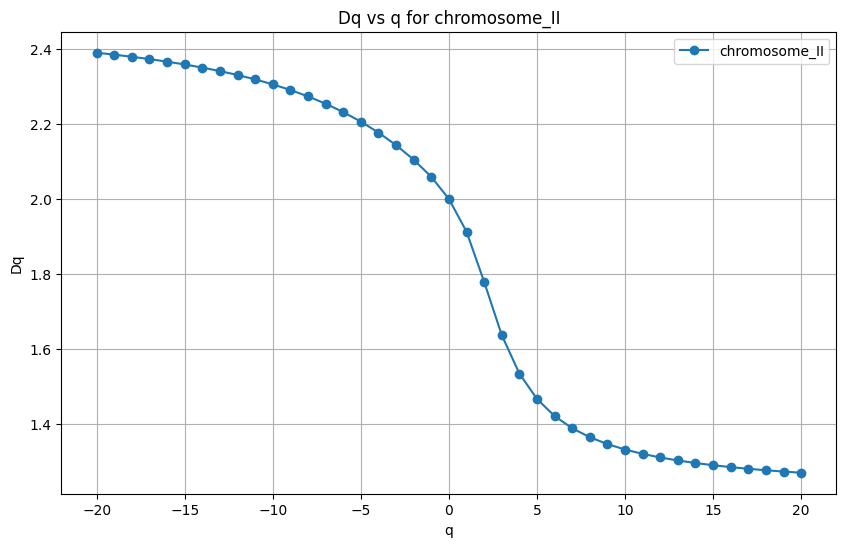

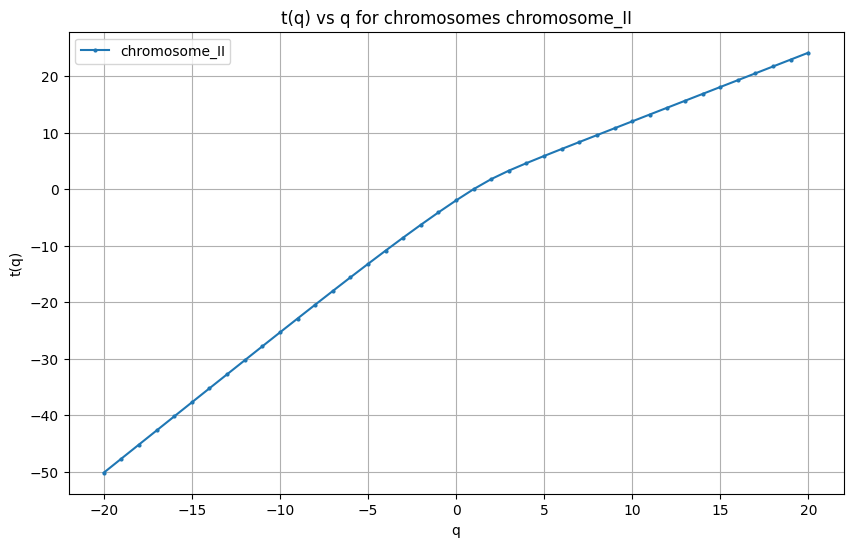

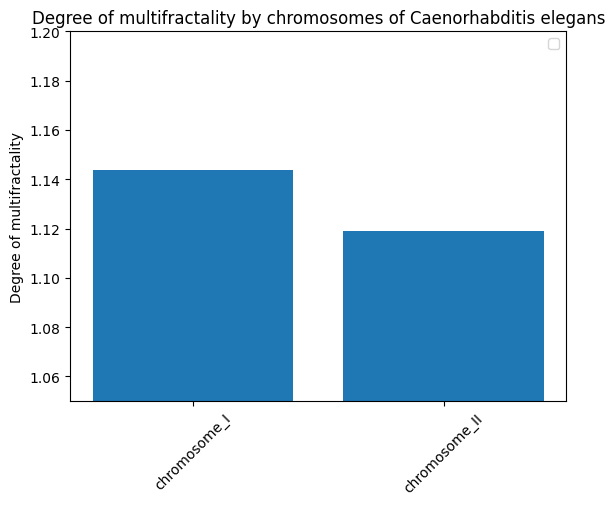

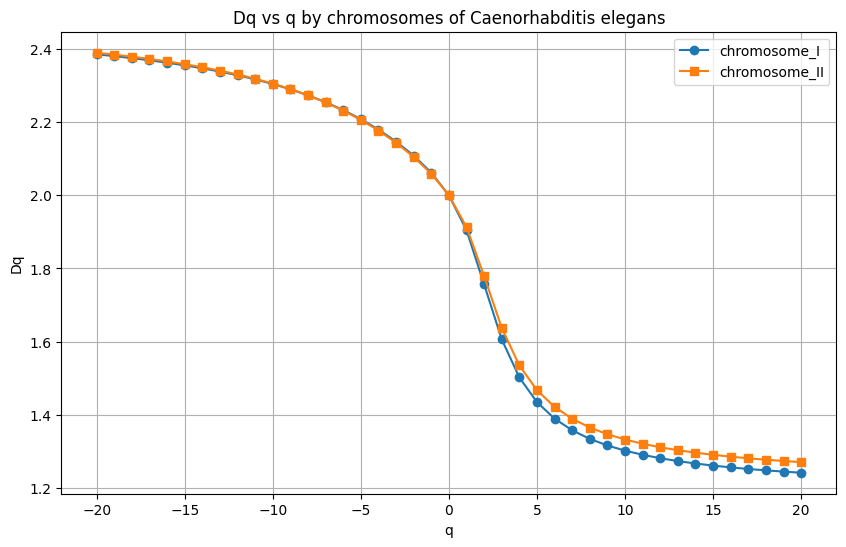

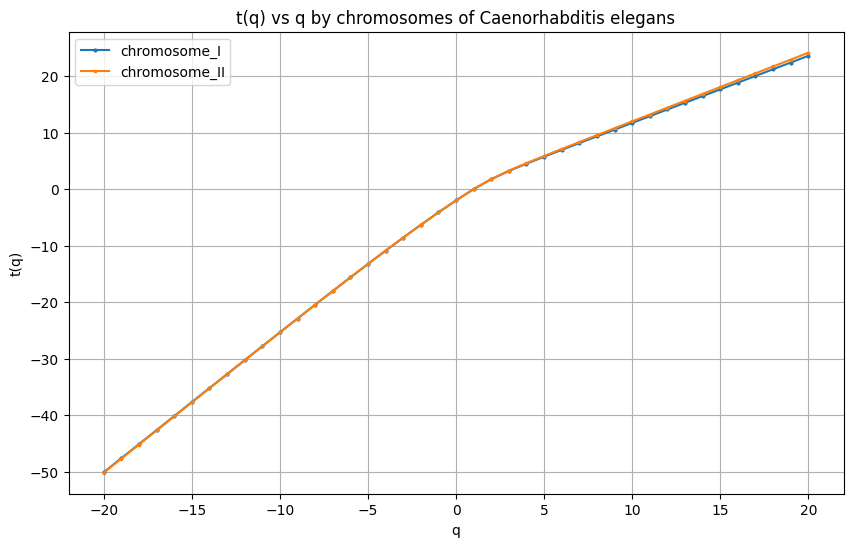

In [247]:
c_elegans_manager.calculate_and_graph_plus_merged(epsilon=0.01)

## Chromosomes of genome divided in regions

Make GenomeManager use SequenceManager. And then look how to make it use RegionSequenceManager as well.

In [ ]:
c_elegans_regions_manager = GenomeManager(genome_data=c_elegans_data, organism_name="Caenorhabditis elegans", regions_number=3)

In [ ]:
c_elegans_regions_genome = c_elegans_regions_manager.get_genome()

In [ ]:
c_elegans_regions_chromosomes = c_elegans_regions_genome.get_chromosomes()
c_elegans_regions_chromosomes

In [ ]:
c_elegans_regions_chromosome_I = c_elegans_regions_chromosomes[0]
c_elegans_regions_chromosome_I


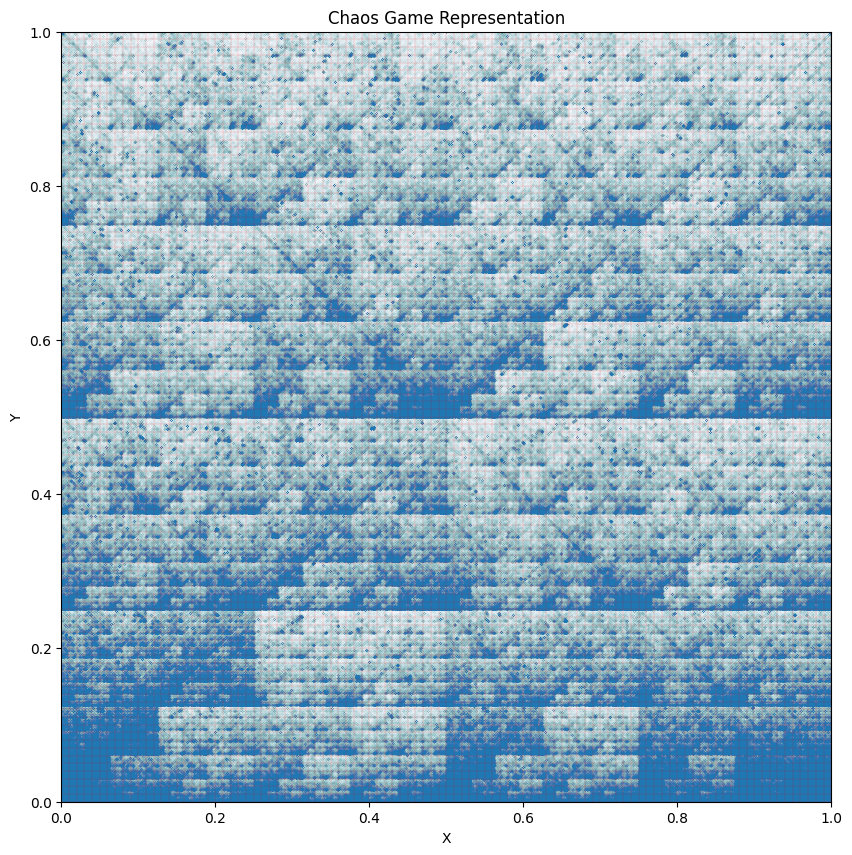

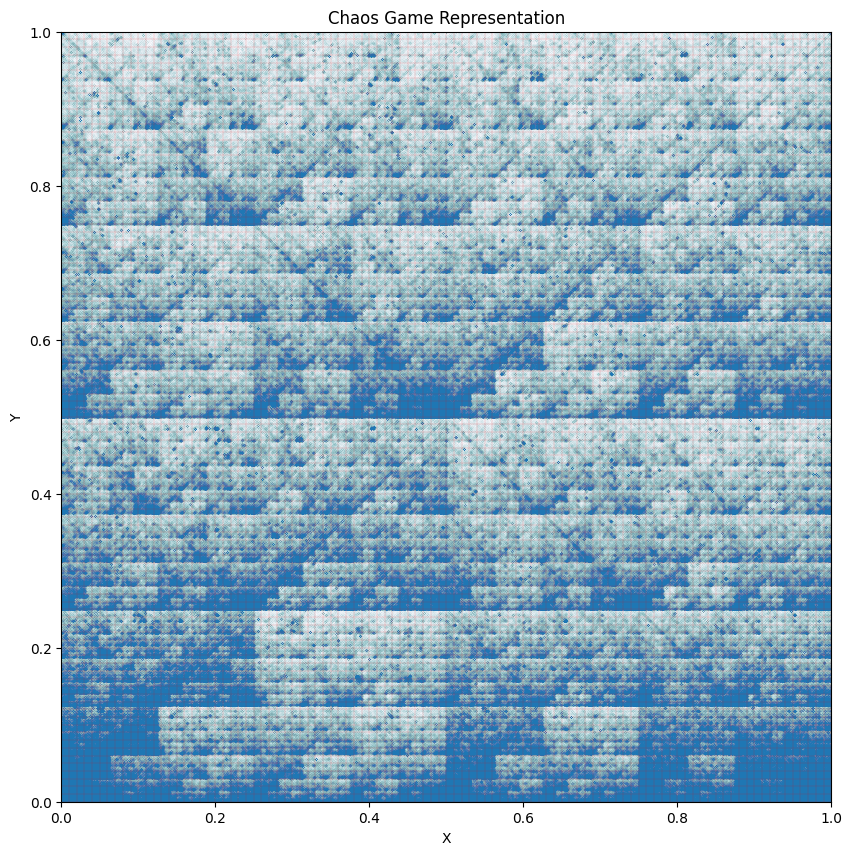

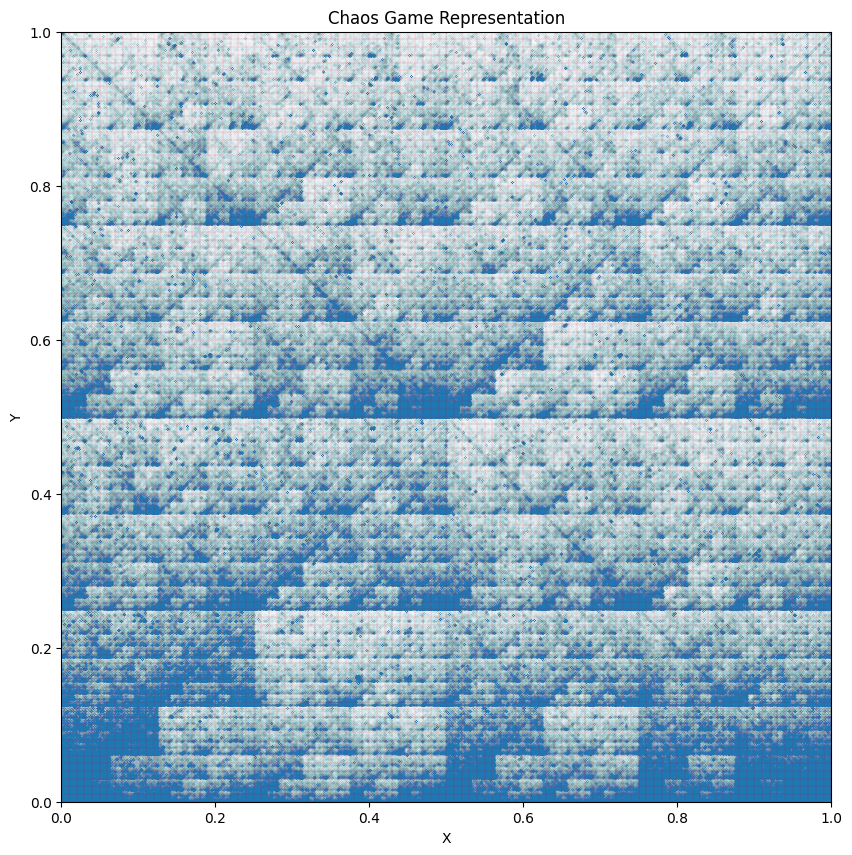

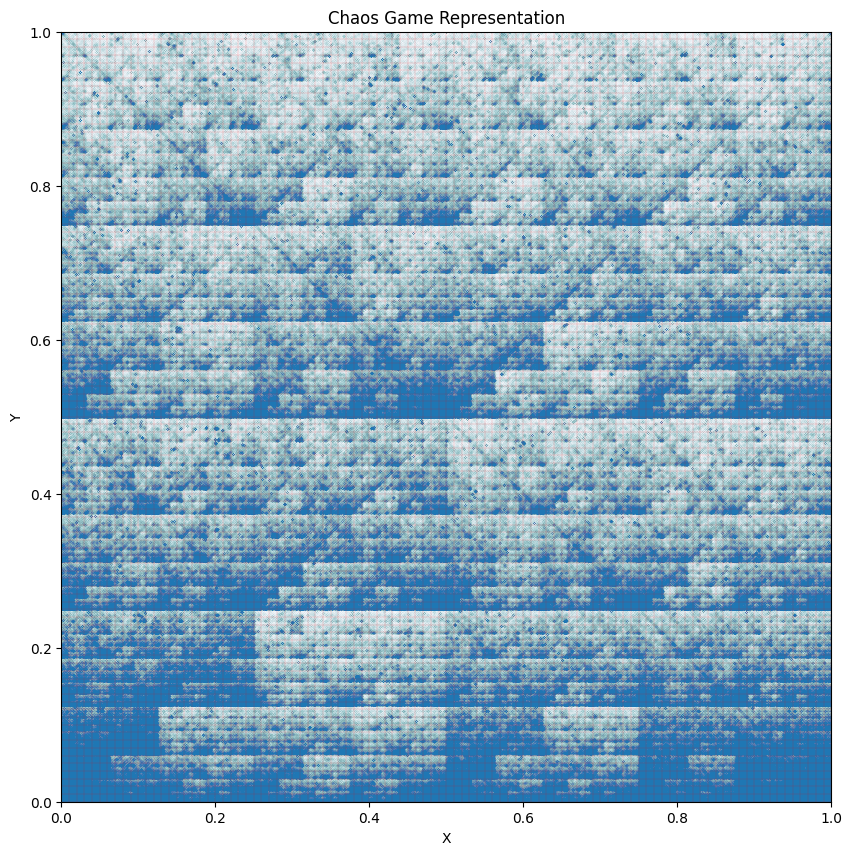

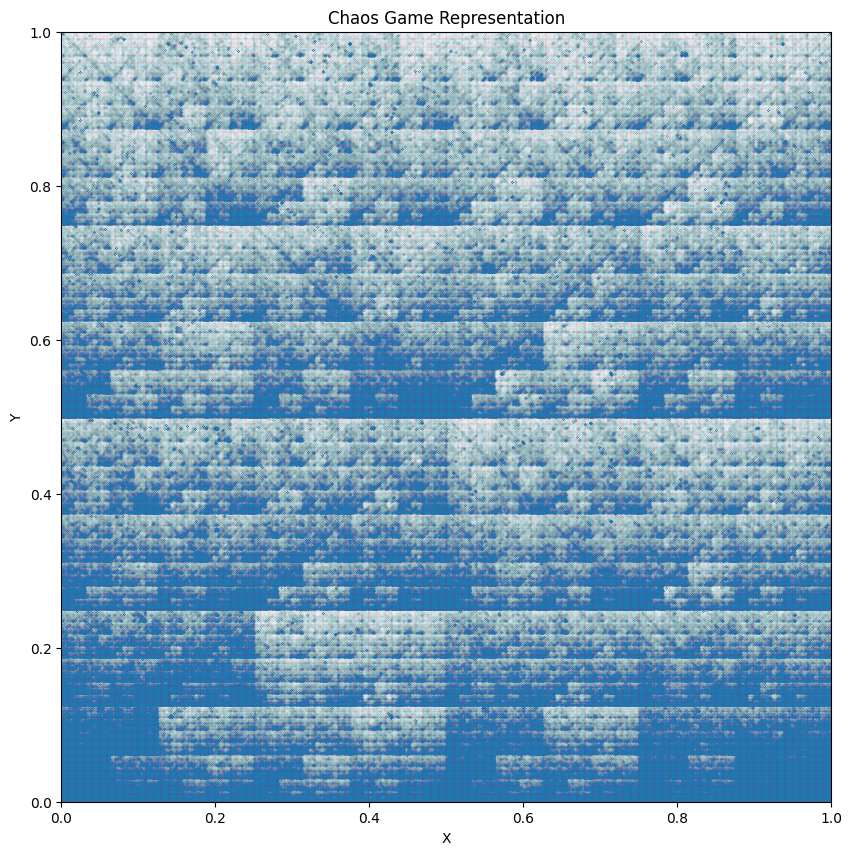

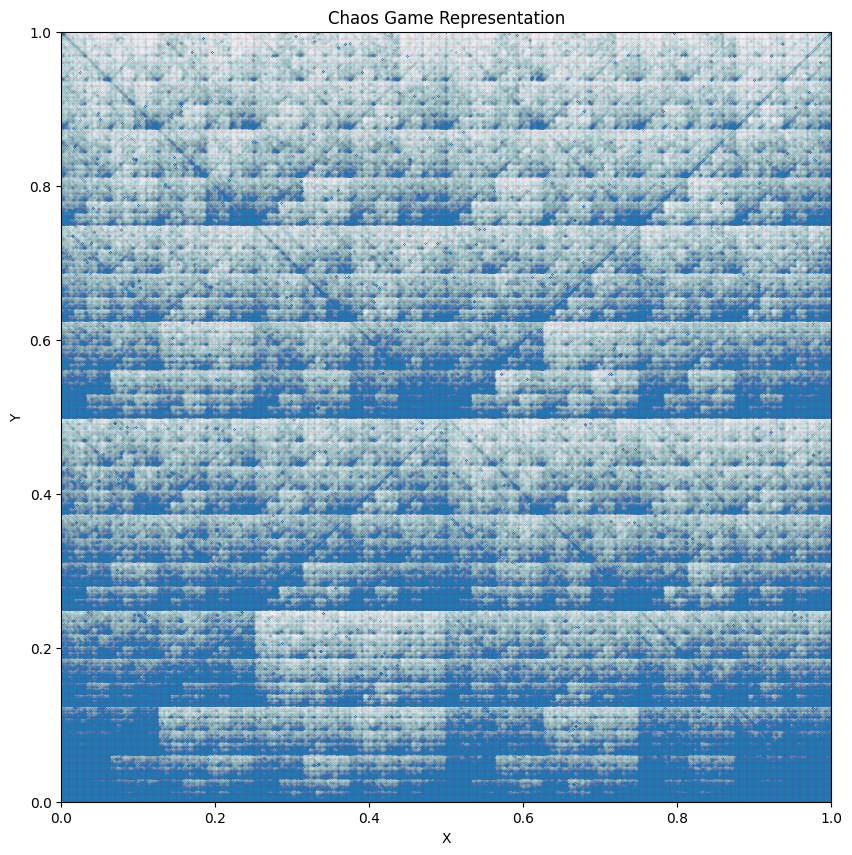

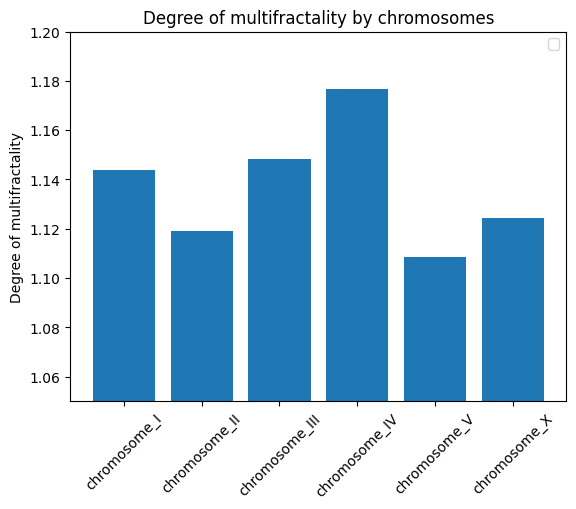

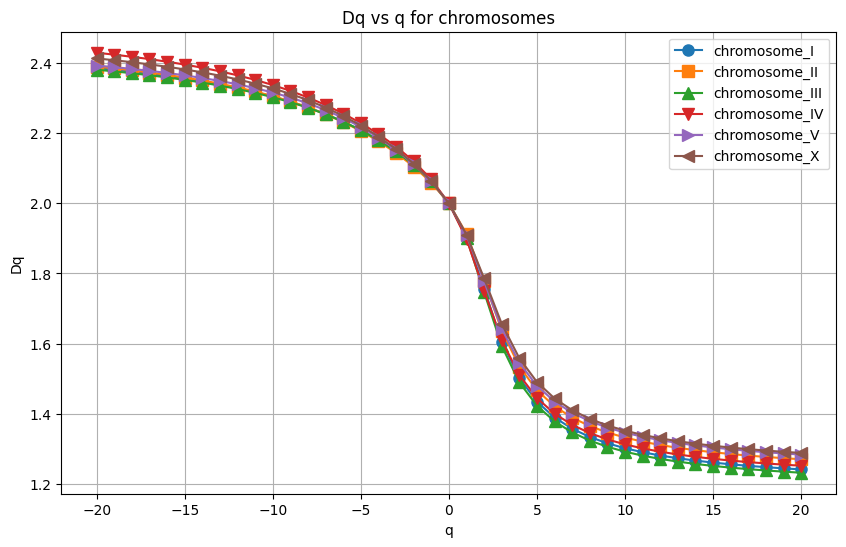

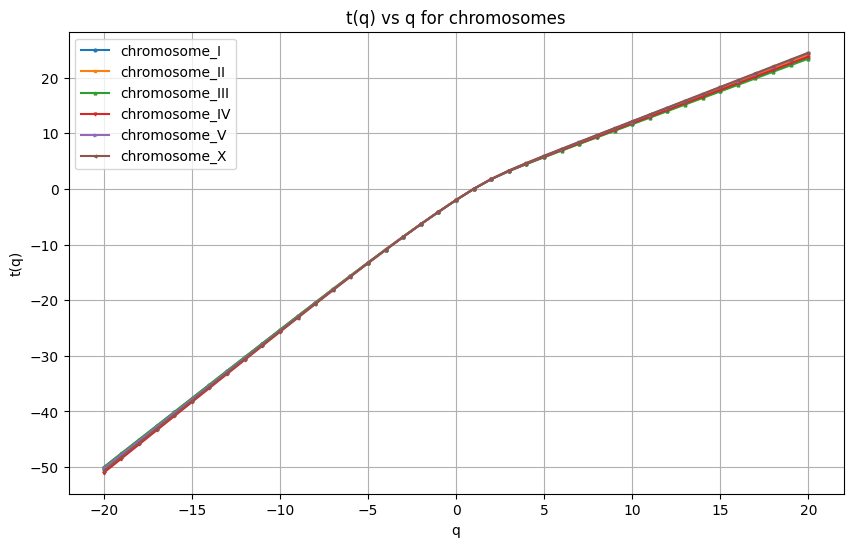

In [ ]:
c_elegans_parts.graph_multifractal_analysis(_3d_cgr=False)